# Project: Investigating Gapminder Fertility Rate & Female Employment Rate Datasets

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
<li><a href="#resources">Resources & References</a></li>
</ul>

<a id='intro'></a>
## Introduction
The aim of this project is to investigate the relationships and trends between the number of children per woman in a given country, and the female employment rates in that country, for nearly 200 countries. We are going to look at the female employment rates from several perspectives. We will look at and make comparisons between three employment sectors. We will also investigate two employment statuses. We will also make comparions between the female employment rates for the employment statuses as a collective on one hand, and the female employment rates for the employment statuses as a different collective on the other. We will obtain datasets, and prepare them for exploration. We will then explore the datasets, and prepare them for more comprehensive analysis. We will end the report by highlighting any patterns that we observe during our analysis, as well as the interpretations and/or significance of those patterns and trends.

### Dataset Description 

This report is on the analysis of datasets from [Gapminder](https://www.gapminder.org/data/). We are going to use female employment rate data for the agriculture, industry, and service sectors. We will also use female employment rate data for family worker and self-employed worker employment statuses. The following datasets were downloaded:
* Total fertility rate per country over several years, given as number of births per woman. The original data source is indicated to be at [this link](http://gapm.io/dtfr). The [documentation](https://www.gapminder.org/data/documentation/gd008/) indicates that data up to 2014 is historical, and data from 2015 onwards is based on projections of the fertility rate, provided by the United Nations. As such, only the data up to 2014 will be considered to be relevant to this project, so as to minimise the assumptions in our datasets, and the errors that might come with them, thus increasing the validity of our conclusions in this report.
* Female employment rate per country over several years, given as the percentage of the female population, aged 15+, that is employed within a given year. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).
* Female employment in the agriculture sector per country over several years, given as the percentage of all female employment that works in agriculture. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).
* Female employment in the industry sector per country over several years, given as the percentage of all female employment that works in industry. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).
* Female employment in the service sector per country over several years, given as the percentage of all female employment that works in the service sector. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).
* Female employment as family workers, given as the percentage of all female employment that works as contributing family workers. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).
* Female employment as self-employed workers, given as the percentage of all female employment that works as self-employed workers. The original data source is indicated to be at [this link](https://www.ilo.org/ilostat/).  

We intended to also include a third employment status, salaried workers, in the investigation but the dataset remained unavailable by the time of completion of this project.

### Questions for Analysis

The acquired data will be used to address the following questions:
1. Do countries with higher fertility rate have higher or lower total female employment rate than those with lower fertility rate?
2. Is the fertility rate more closely related to the female employment rate in any particular employment sector(s) than in any other sector(s)?
3. Is the fertility rate more closely related to the female employment rate for one particular employment status than the other status?
4. Is fertility rate more closely related to female employment rate by sector or female employment rate by employment status?
5. Is female employment rate in any particular sector(s) more closely related to female employment rate for any particular employment status(es)?

In [1]:
# Importing required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

%matplotlib inline

<a id='wrangling'></a>
## Data Wrangling

In this section, we will load our datasets, assess whether and where trimming and data cleaning are applicable, and then execute those steps as necessary. Finally, we will merge relevant segments of the disparate datasets into the final form(s) which we will use for analysis.


### General Properties

In this first subsection, we will look at the general properties of our dataset, and note where further data cleaning is required. We will also indicate and lay out the precise cleaning steps that we will later carry out.

#### Dataset 1: Fertility Rate

In [2]:
# We load the first dataset, which shows the total fertility rate by country
df_fertility = pd.read_csv("children_per_woman_total_fertility.csv")

In [3]:
# We show the first few lines of the dataframe to check it loaded correctly
df_fertility.head()

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2091,2092,2093,2094,2095,2096,2097,2098,2099,2100
0,Aruba,5.64,5.64,5.64,5.64,5.64,5.64,5.64,5.64,5.64,...,1.82,1.82,1.82,1.82,1.82,1.82,1.82,1.82,1.83,1.83
1,Afghanistan,7.00,7.00,7.00,7.00,7.00,7.00,7.00,7.00,7.00,...,1.74,1.74,1.74,1.74,1.74,1.74,1.74,1.74,1.74,1.74
2,Angola,6.93,6.93,6.93,6.93,6.93,6.93,6.93,6.94,6.94,...,2.54,2.52,2.50,2.48,2.47,2.45,2.43,2.42,2.40,2.40
3,Albania,4.60,4.60,4.60,4.60,4.60,4.60,4.60,4.60,4.60,...,1.78,1.78,1.78,1.79,1.79,1.79,1.79,1.79,1.79,1.79
4,Netherlands Antilles,5.80,5.80,5.80,5.80,5.80,5.80,5.80,5.80,5.80,...,2.00,2.00,2.01,2.01,2.01,2.01,2.01,2.02,2.02,2.02


We can see that the dataframe contains fertility rate data for a number of countries, starting from the year 1800, with projections up to 2100, which covers a period of 301 years. We will only be interested in data up to the latest full year, and so we will drop the columns from the current year (2022) going forward. Depending on further findings below, we may also need to drop columns earlier than a certain period, which is yet to be determined at this juncture in the report.

Next, we'll check how many rows are present in the dataframe.

In [4]:
df_fertility.shape

(202, 302)

This tells us that there are 202 records, presumably for 202 countries, in our dataframe.

We inspect the dataframe in further detail.

In [5]:
df_fertility.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202 entries, 0 to 201
Columns: 302 entries, country to 2100
dtypes: float64(301), object(1)
memory usage: 476.7+ KB


We find that the data type for 301 of the columns is *float*, and 1 column likely has the *string* data type. This is most likely the *country* column.

We verify this by looking at the data types below.

In [6]:
df_fertility.dtypes

country     object
1800       float64
1801       float64
1802       float64
1803       float64
1804       float64
1805       float64
1806       float64
1807       float64
1808       float64
1809       float64
1810       float64
1811       float64
1812       float64
1813       float64
1814       float64
1815       float64
1816       float64
1817       float64
1818       float64
1819       float64
1820       float64
1821       float64
1822       float64
1823       float64
1824       float64
1825       float64
1826       float64
1827       float64
1828       float64
            ...   
2071       float64
2072       float64
2073       float64
2074       float64
2075       float64
2076       float64
2077       float64
2078       float64
2079       float64
2080       float64
2081       float64
2082       float64
2083       float64
2084       float64
2085       float64
2086       float64
2087       float64
2088       float64
2089       float64
2090       float64
2091       float64
2092       f

In [7]:
# Checking the data type of the first element of the country column
type(df_fertility["country"][0])

str

The above confirms that the first column has the *string* data type.

We double check that all the intermediate columns that were not shown above have the *float* data type.

In [8]:
# Aggregated counts of the data types in the dataframe
df_fertility.dtypes.value_counts()

float64    301
object       1
dtype: int64

This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [9]:
df_fertility.describe()

,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,...,2091,2092,2093,2094,2095,2096,2097,2098,2099,2100
count,202.000000,202.000000,202.000000,202.000000,202.000000,202.000000,202.000000,202.000000,202.000000,202.000000,...,201.000000,201.000000,201.000000,201.000000,201.00000,201.000000,201.000000,201.000000,201.000000,201.000000
mean,6.086832,6.084010,6.087030,6.086089,6.086386,6.086089,6.082030,6.080792,6.073317,6.062426,...,1.888209,1.885075,1.882587,1.880448,1.87806,1.875622,1.873731,1.871692,1.869453,1.869453
std,0.776515,0.779904,0.774461,0.773842,0.774033,0.770959,0.775947,0.776953,0.790581,0.816860,...,0.190299,0.184603,0.179333,0.173866,0.16854,0.163281,0.158583,0.153874,0.148725,0.148725
min,4.040000,4.040000,3.910000,4.050000,3.940000,4.060000,4.070000,4.050000,4.000000,3.210000,...,1.440000,1.440000,1.450000,1.450000,1.45000,1.450000,1.450000,1.450000,1.450000,1.450000
25%,5.622500,5.622500,5.625000,5.625000,5.640000,5.625000,5.625000,5.625000,5.625000,5.625000,...,1.770000,1.780000,1.780000,1.780000,1.78000,1.780000,1.780000,1.780000,1.780000,1.780000
50%,6.155000,6.155000,6.155000,6.155000,6.155000,6.155000,6.155000,6.155000,6.140000,6.135000,...,1.810000,1.810000,1.810000,1.810000,1.81000,1.810000,1.810000,1.810000,1.810000,1.810000
75%,6.685000,6.685000,6.685000,6.685000,6.685000,6.685000,6.685000,6.685000,6.685000,6.685000,...,1.920000,1.920000,1.920000,1.920000,1.92000,1.920000,1.920000,1.910000,1.910000,1.910000
max,8.100000,8.100000,8.100000,8.100000,8.100000,8.100000,8.100000,8.100000,8.100000,8.100000,...,2.630000,2.600000,2.580000,2.550000,2.53000,2.510000,2.500000,2.480000,2.460000,2.460000


Some of the columns towards the end show the existence of missing values. We will address these later.

We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [10]:
# Checking the highest value in the max row of the descriptive statistics table
df_fertility.describe().loc["max"].max()

8.87

In [11]:
# Checking the lowest value in the min row of the descriptive statistics table
df_fertility.describe().loc["min"].min()

0.83

The lowest *min* value is not a negative number. The highest *max* value is not inordinately large. We conclude these are both reasonable values for the fertility rate. 

We then turn to missing values.

In [12]:
# Checking the number of null values for each column
df_fertility.isnull().sum()

country    0
1800       0
1801       0
1802       0
1803       0
1804       0
1805       0
1806       0
1807       0
1808       0
1809       0
1810       0
1811       0
1812       0
1813       0
1814       0
1815       0
1816       0
1817       0
1818       0
1819       0
1820       0
1821       0
1822       0
1823       0
1824       0
1825       0
1826       0
1827       0
1828       0
          ..
2071       1
2072       1
2073       1
2074       1
2075       1
2076       1
2077       1
2078       1
2079       1
2080       1
2081       1
2082       1
2083       1
2084       1
2085       1
2086       1
2087       1
2088       1
2089       1
2090       1
2091       1
2092       1
2093       1
2094       1
2095       1
2096       1
2097       1
2098       1
2099       1
2100       1
Length: 302, dtype: int64

The columns towards the end show missing values as indicated earlier. We look at a summary count of the null values.

In [13]:
# Aggregated counts of the null values in the dataframe
df_fertility.isnull().sum().value_counts()

0    215
1     87
dtype: int64

215 columns have no missing values. There are 87 columns missing 1 value each. We take a look at which columns these are.

In [14]:
# Mask extracting columns that have a missing value
df_fertility.isnull().sum()[df_fertility.isnull().sum() == 1]

2014    1
2015    1
2016    1
2017    1
2018    1
2019    1
2020    1
2021    1
2022    1
2023    1
2024    1
2025    1
2026    1
2027    1
2028    1
2029    1
2030    1
2031    1
2032    1
2033    1
2034    1
2035    1
2036    1
2037    1
2038    1
2039    1
2040    1
2041    1
2042    1
2043    1
       ..
2071    1
2072    1
2073    1
2074    1
2075    1
2076    1
2077    1
2078    1
2079    1
2080    1
2081    1
2082    1
2083    1
2084    1
2085    1
2086    1
2087    1
2088    1
2089    1
2090    1
2091    1
2092    1
2093    1
2094    1
2095    1
2096    1
2097    1
2098    1
2099    1
2100    1
Length: 87, dtype: int64

It would seem the 87 columns from 2014 going forward are each missing 1 data point. We need to check whether only 1 record is missing all 87 values, or if the missing values are spread out across multiple rows.

In [15]:
# Extracting all rows that have at least 1 missing value in any column
df_fertility[df_fertility.isnull().any(axis=1)]

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2091,2092,2093,2094,2095,2096,2097,2098,2099,2100
73,Greenland,4.9,4.89,4.88,4.87,4.86,4.84,4.83,4.82,4.81,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Only 1 row shows up as having missing values. This means there is no data for Greenland from 2014 onwards. Since we were going to drop all columns from 2022 going forward, we can modify that step to instead drop all columns starting from 2014. Doing this will allow us to still use the data for Greenland, without introducing the slight inaccuracies that can come from trying to replace the missing values.

We quickly double check that there would no longer be any missing values from anywhere else in the dataframe after that modification.

In [16]:
# Checking null values for subset of dataframe up to and including 2013
df_fertility.loc[:, :"2013"].isnull().sum().value_counts()

0    215
dtype: int64

Next, we check for duplicate rows in our dataframe.

In [17]:
# The total number of duplicated rows across the dataframe
df_fertility.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [18]:
# Checking for duplicates in country column
df_fertility["country"].nunique()

202

202 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 2: Female Employment Rate

In [19]:
# We load the next dataset, which shows the total female employment rate by country
df_employment = pd.read_csv("females_aged_15plus_employment_rate_percent.csv")

In [20]:
# We show the first few lines of the dataframe to check it loaded correctly
df_employment.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,13.2,13.2,13.1,13.1,13.1,13.0,12.8,12.8,12.7,...,12.9,13.2,13.5,14.3,15.2,16.1,17.0,18.0,18.4,18.8
1,Angola,73.9,73.7,73.6,73.6,73.5,73.4,73.5,73.4,73.4,...,67.5,70.0,70.0,70.1,70.2,70.3,70.4,70.5,70.6,70.6
2,Albania,50.8,51.2,49.5,48.3,46.5,45.5,46.9,45.6,44.2,...,38.5,45.7,42.8,38.0,36.5,38.2,41.1,41.6,44.6,46.5
3,United Arab Emirates,28.2,28.9,29.8,30.2,30.6,30.9,31.2,31.7,32.3,...,41.7,42.7,43.9,45.3,46.9,48.3,49.3,48.8,49.1,48.8
4,Argentina,43.6,43.8,41.8,41.6,37.4,39.3,40.8,43.0,42.3,...,43.5,44.1,44.1,43.9,43.4,43.9,44.3,44.7,45.5,45.9


We can see that the dataframe contains employment rate data for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward. This dataset starts from 1991. Hence, we will need to drop columns earlier than 1991 from the fertility rate dataframe.

Next, we'll check how many rows are present in this dataframe.

In [21]:
df_employment.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe. We'll need to work with a final dataset which covers the same set of countries for all our indicators. As such, we will evidently need to drop some of the rows in the fertility rate dataset, and potentially in some of our other subsequent datasets as well if there are additonal disparities there.

We inspect the dataframe in further detail.

In [22]:
df_employment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [23]:
# Checking the data type of the first element of the country column
type(df_employment["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [24]:
df_employment.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,45.178360,45.256878,45.102646,45.169206,45.191164,45.162328,45.324286,45.457460,45.581746,45.689894,...,46.650159,46.784339,46.951481,46.985132,47.125344,47.329259,47.459735,47.698148,47.952328,48.131270
std,17.536015,17.396864,17.286070,17.154633,17.154089,17.083587,17.012273,16.898297,16.791341,16.768212,...,16.109842,16.101442,16.027207,15.880182,15.809631,15.710120,15.720134,15.731199,15.808064,15.749974
min,7.450000,7.570000,7.640000,7.710000,7.790000,7.880000,7.960000,8.270000,8.430000,8.360000,...,8.080000,7.040000,6.030000,5.190000,4.490000,4.530000,4.490000,4.490000,4.490000,4.510000
25%,32.100000,32.700000,33.000000,33.100000,33.200000,32.200000,32.500000,34.300000,34.200000,34.800000,...,39.000000,38.900000,39.400000,39.200000,39.500000,39.900000,40.000000,40.500000,40.500000,40.300000
50%,44.800000,45.300000,44.900000,45.200000,45.400000,45.500000,45.700000,45.500000,45.400000,45.800000,...,46.600000,47.000000,47.400000,47.700000,47.800000,48.300000,48.900000,49.000000,49.500000,49.200000
75%,56.600000,56.000000,55.300000,55.500000,55.500000,55.000000,55.700000,55.800000,56.300000,56.400000,...,56.700000,56.900000,57.000000,55.800000,56.800000,56.400000,56.800000,57.100000,57.400000,57.700000
max,89.200000,88.700000,88.000000,87.400000,86.800000,86.000000,85.500000,85.700000,85.800000,85.800000,...,83.200000,84.800000,86.000000,84.800000,83.500000,82.900000,82.900000,83.000000,83.000000,83.000000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [25]:
# Checking the highest value in the max row of the descriptive statistics table
df_employment.describe().loc["max"].max()

89.2

In [26]:
# Checking the lowest value in the min row of the descriptive statistics table
df_employment.describe().loc["min"].min()

4.49

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the employment rate. 

We then check for missing values.

In [27]:
df_employment.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [28]:
# Aggregated counts of the null values in the dataframe
df_employment.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [29]:
# The total number of duplicated rows across the dataframe
df_employment.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [30]:
# Checking for duplicates in country column
df_employment["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 3: Female Agriculture Workers

In [31]:
# We load the next dataset, which shows the percentage of female employment in agriculture by country
df_agric = pd.read_csv("female_agriculture_workers_percent_of_female_employment.csv")

In [32]:
# We show the first few lines of the dataframe to check it loaded correctly
df_agric.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,76.4000,76.4000,76.8000,76.3000,76.7000,77.0000,77.4000,77.8000,78.2000,...,72.9000,72.4000,70.9000,70.0000,69.200,68.6000,67.6000,66.2000,65.80000,65.0000
1,Angola,45.7000,46.6000,47.1000,47.5000,46.8000,46.2000,45.5000,44.4000,45.2000,...,55.5000,58.0000,58.4000,58.5000,58.200,57.8000,57.5000,57.2000,57.10000,56.8000
2,Albania,66.2000,65.1000,64.6000,64.0000,63.3000,64.8000,65.5000,65.0000,64.7000,...,53.1000,54.4000,57.0000,53.2000,49.900,47.7000,45.2000,42.4000,42.30000,41.6000
3,United Arab Emirates,0.0659,0.0643,0.0638,0.0618,0.0601,0.0603,0.0602,0.0599,0.0592,...,0.0205,0.0186,0.0169,0.0154,0.014,0.0127,0.0115,0.0101,0.00904,0.0084
4,Argentina,0.1380,0.3240,0.2990,0.2420,0.3650,0.2230,0.2570,0.2310,0.2360,...,0.3830,0.2860,0.2850,0.2270,0.156,0.0725,0.0333,0.0154,0.05830,0.0312


We can see that the dataframe contains data about the proportion of female employment that is in the agricultural sector, for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward.

Next, we'll check how many rows are present in this dataframe.

In [33]:
df_agric.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe.

We inspect the dataframe in further detail.

In [34]:
df_agric.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [35]:
# Checking the data type of the first element of the country column
type(df_agric["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [36]:
df_agric.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,33.480830,33.393331,33.151060,33.002302,32.709386,32.371299,32.124766,31.854728,31.613943,31.445520,...,26.764372,26.359096,25.893603,25.461409,24.876577,24.257989,23.690289,23.212104,22.615155,22.124320
std,29.654988,29.649933,29.584986,29.577372,29.484867,29.374237,29.302096,29.211927,29.115991,29.144182,...,27.036726,26.847483,26.483235,26.320940,25.989932,25.640657,25.379231,25.040930,24.726827,24.501027
min,0.016500,0.016100,0.015600,0.015200,0.014800,0.012400,0.010400,0.014300,0.017600,0.022500,...,0.018100,0.018600,0.016900,0.009970,0.010300,0.009950,0.010000,0.010100,0.009040,0.008400
25%,6.780000,6.590000,6.080000,5.930000,5.900000,5.610000,5.320000,5.070000,4.760000,4.400000,...,2.810000,2.860000,2.950000,2.610000,2.670000,2.640000,2.840000,2.590000,2.560000,2.380000
50%,23.400000,23.600000,22.900000,23.000000,22.600000,22.100000,21.200000,20.700000,20.400000,20.300000,...,15.800000,14.900000,13.500000,12.700000,12.400000,12.100000,11.300000,10.900000,10.500000,9.780000
75%,55.700000,55.500000,54.900000,55.100000,54.600000,54.100000,54.200000,53.600000,54.100000,54.800000,...,47.300000,44.800000,43.900000,43.900000,43.300000,42.800000,41.000000,40.400000,39.900000,38.300000
max,96.800000,96.800000,96.800000,96.800000,96.800000,96.800000,96.800000,96.700000,96.700000,96.600000,...,94.900000,94.700000,94.500000,94.100000,93.800000,93.900000,93.900000,93.900000,93.800000,93.700000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [37]:
# Checking the highest value in the max row of the descriptive statistics table
df_agric.describe().loc["max"].max()

96.8

In [38]:
# Checking the lowest value in the min row of the descriptive statistics table
df_agric.describe().loc["min"].min()

0.0084

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the agricultural sector employment rate. 

We then check for missing values.

In [39]:
# Checking the number of null values for each column
df_agric.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [40]:
# Aggregated counts of the null values in the dataframe
df_agric.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [41]:
# The total number of duplicated rows across the dataframe
df_agric.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [42]:
# Checking for duplicates in country column
df_agric["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 4: Female Industry Workers

In [43]:
# We load the next dataset, which shows the percentage of female employment in industry by country
df_industry = pd.read_csv("female_industry_workers_percent_of_female_employment.csv")

In [44]:
# We show the first few lines of the dataframe to check it loaded correctly
df_industry.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,14.60,14.40,13.90,14.00,13.80,13.30,12.90,12.50,12.00,...,16.40,17.30,19.00,20.10,21.10,21.90,22.900,24.30,24.500,25.00
1,Angola,2.02,1.94,1.91,1.85,1.82,1.79,1.80,1.84,1.77,...,1.16,1.12,1.08,1.05,1.02,1.01,0.996,0.97,0.942,0.92
2,Albania,6.77,6.85,6.91,6.99,7.10,6.72,6.45,6.49,6.52,...,10.60,11.40,10.60,10.20,11.80,14.00,14.800,15.20,15.700,16.30
3,United Arab Emirates,14.40,14.20,14.10,14.00,13.80,13.70,13.80,13.70,13.70,...,7.00,6.69,6.43,6.26,6.14,6.05,5.900,5.68,5.530,5.42
4,Argentina,20.00,19.10,16.30,14.60,15.10,12.60,11.70,10.80,10.90,...,9.44,10.00,9.53,8.98,8.39,8.66,8.880,9.17,9.140,9.20


We can see that the dataframe contains data about the proportion of female employment that is in the industry sector, for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward.

Next, we'll check how many rows are present in this dataframe.

In [45]:
df_industry.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe.

We inspect the dataframe in further detail.

In [46]:
df_industry.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [47]:
# Checking the data type of the first element of the country column
type(df_industry["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [48]:
df_industry.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,15.756132,15.447989,15.163233,14.955397,14.722233,14.472116,14.224603,14.046079,13.784503,13.546899,...,11.676958,11.639646,11.585862,11.503328,11.600995,11.582772,11.571206,11.619582,11.659952,11.629000
std,10.635723,10.282301,10.004264,9.826127,9.620317,9.481558,9.303778,9.174981,8.995839,8.904245,...,7.417807,7.378362,7.340338,7.304000,7.409840,7.349726,7.333760,7.356583,7.370698,7.367902
min,0.104000,0.104000,0.109000,0.114000,0.118000,0.126000,0.120000,0.124000,0.135000,0.145000,...,0.627000,0.593000,0.594000,0.593000,0.576000,0.574000,0.580000,0.583000,0.552000,0.537000
25%,7.770000,7.770000,7.860000,7.880000,7.770000,7.460000,7.690000,7.830000,7.810000,7.330000,...,6.690000,6.570000,6.710000,6.590000,6.730000,6.530000,6.500000,6.840000,6.900000,7.030000
50%,14.500000,14.400000,14.400000,14.200000,13.800000,13.300000,13.300000,12.900000,12.500000,12.300000,...,10.500000,10.400000,10.300000,10.100000,9.880000,9.740000,9.640000,9.710000,9.620000,9.540000
75%,20.900000,20.800000,20.400000,19.900000,19.800000,19.600000,18.900000,18.800000,18.300000,18.300000,...,15.500000,15.400000,15.100000,14.800000,15.000000,15.200000,15.600000,15.600000,16.100000,16.200000
max,61.300000,59.700000,58.400000,57.900000,58.100000,58.100000,58.200000,58.400000,58.700000,59.100000,...,53.100000,51.900000,50.800000,49.500000,48.400000,47.400000,46.600000,45.900000,45.100000,45.000000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [49]:
# Checking the highest value in the max row of the descriptive statistics table
df_industry.describe().loc["max"].max()

61.3

In [50]:
# Checking the lowest value in the min row of the descriptive statistics table
df_industry.describe().loc["min"].min()

0.10400000000000001

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the industry sector employment rate. 

We then check for missing values.

In [51]:
# Checking the number of null values for each column
df_industry.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [52]:
# Aggregated counts of the null values in the dataframe
df_industry.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [53]:
# The total number of duplicated rows across the dataframe
df_industry.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [54]:
# Checking for duplicates in country column
df_industry["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 5: Female Service Workers

In [55]:
# We load the next dataset, which shows the percentage of female employment in service work by country
df_service = pd.read_csv("female_service_workers_percent_of_female_employment.csv")

In [56]:
# We show the first few lines of the dataframe to check it loaded correctly
df_service.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,9.06,9.2,9.33,9.62,9.56,9.61,9.67,9.75,9.81,...,10.7,10.3,10.1,9.9,9.73,9.53,9.51,9.5,9.72,10.0
1,Angola,52.20,51.5,51.00,50.70,51.40,52.00,52.70,53.70,53.00,...,43.4,40.9,40.5,40.5,40.80,41.20,41.50,41.8,42.00,42.3
2,Albania,27.10,28.0,28.50,29.00,29.60,28.40,28.10,28.50,28.70,...,36.3,34.2,32.4,36.6,38.40,38.30,39.90,42.4,42.10,42.1
3,United Arab Emirates,85.60,85.7,85.90,86.00,86.20,86.20,86.10,86.20,86.30,...,93.0,93.3,93.6,93.7,93.80,93.90,94.10,94.3,94.50,94.6
4,Argentina,79.90,80.6,83.40,85.10,84.50,87.20,88.10,89.00,88.90,...,90.2,89.7,90.2,90.8,91.50,91.30,91.10,90.8,90.80,90.8


We can see that the dataframe contains data about the proportion of female employment that is in the service sector, for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward.

Next, we'll check how many rows are present in this dataframe.

In [57]:
df_service.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe.

We inspect the dataframe in further detail.

In [58]:
df_service.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [59]:
# Checking the data type of the first element of the country column
type(df_service["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [60]:
df_service.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,50.766984,51.155132,51.688307,52.045608,52.562063,53.157143,53.654974,54.100635,54.601164,55.006614,...,61.557037,62.002487,62.521005,63.040688,63.524603,64.157672,64.735979,65.165608,65.724497,66.250423
std,25.903269,25.984325,26.029398,26.128385,26.131363,26.106260,26.122833,26.079799,26.135723,26.238129,...,25.634746,25.522752,25.305279,25.205367,24.967333,24.714231,24.503048,24.253757,23.993862,23.824900
min,1.610000,2.350000,2.410000,2.410000,2.420000,2.480000,2.520000,2.550000,2.620000,2.680000,...,4.280000,4.470000,4.670000,4.990000,5.220000,5.170000,5.190000,5.200000,5.310000,5.430000
25%,29.700000,29.600000,31.000000,30.100000,29.600000,31.700000,31.700000,33.000000,32.500000,31.700000,...,41.500000,41.400000,42.000000,43.200000,45.700000,47.300000,48.300000,48.900000,50.500000,51.500000
50%,52.100000,51.700000,52.500000,52.900000,53.300000,54.100000,55.700000,56.400000,56.900000,57.000000,...,69.000000,68.400000,69.000000,70.100000,70.300000,72.300000,72.800000,72.900000,73.200000,73.500000
75%,73.500000,73.600000,74.500000,74.800000,75.800000,77.000000,77.700000,78.300000,79.000000,79.600000,...,84.500000,84.700000,85.500000,85.500000,86.100000,85.800000,85.800000,85.900000,86.000000,86.300000
max,98.000000,98.000000,97.900000,97.900000,98.000000,97.900000,98.000000,97.700000,97.500000,97.400000,...,98.300000,98.200000,98.100000,97.900000,98.100000,97.900000,97.800000,97.600000,97.500000,97.600000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [61]:
# Checking the highest value in the max row of the descriptive statistics table
df_service.describe().loc["max"].max()

98.7

In [62]:
# Checking the lowest value in the min row of the descriptive statistics table
df_service.describe().loc["min"].min()

1.61

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the service sector employment rate. 

We then check for missing values.

In [63]:
# Checking the number of null values for each column
df_service.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [64]:
# Aggregated counts of the null values in the dataframe
df_service.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [65]:
# The total number of duplicated rows across the dataframe
df_service.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [66]:
# Checking for duplicates in country column
df_service["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 6: Female Family Workers

In [67]:
# We load the next dataset, which shows the percentage of female employment with family worker status by country
df_family = pd.read_csv("female_family_workers_percent_of_female_employment.csv")

In [68]:
# We show the first few lines of the dataframe to check it loaded correctly
df_family.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,87.00000,87.10000,87.50000,87.90000,87.70000,88.00000,88.40000,88.70000,89.00000,...,84.70000,83.4000,81.5000,79.3000,77.1000,74.8000,72.0000,68.600,68.200,67.300
1,Angola,9.69000,8.34000,8.24000,6.23000,6.16000,5.71000,6.40000,7.11000,4.39000,...,11.50000,12.1000,11.6000,12.7000,14.4000,15.5000,14.5000,14.000,13.500,11.900
2,Albania,45.30000,49.10000,49.30000,49.00000,47.40000,46.30000,51.50000,50.40000,47.70000,...,44.10000,43.2000,50.5000,45.7000,41.8000,40.0000,31.2000,30.300,28.900,29.200
3,United Arab Emirates,0.00094,0.00086,0.00078,0.00072,0.00067,0.00063,0.00059,0.00055,0.00052,...,0.00762,0.0102,0.0124,0.0146,0.0173,0.0189,0.0232,0.156,1.610,3.740
4,Argentina,1.81000,2.02000,2.11000,2.56000,2.08000,2.75000,2.35000,2.13000,2.01000,...,1.25000,1.1800,0.8530,0.7910,0.9520,0.9610,0.9720,0.977,0.785,0.813


We can see that the dataframe contains data about the proportion of female employment that has family worker status, for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward.

Next, we'll check how many rows are present in this dataframe.

In [69]:
df_family.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe.

We inspect the dataframe in further detail.

In [70]:
df_family.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [71]:
# Checking the data type of the first element of the country column
type(df_family["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [72]:
df_family.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,20.150116,20.239833,20.237910,20.091539,19.962831,19.666300,19.522860,19.431777,19.219624,18.882389,...,15.443091,14.923169,14.561966,14.295604,13.959480,13.625115,13.091456,12.492408,12.154419,11.753828
std,20.817137,20.860877,20.828737,20.803444,20.738982,20.613341,20.502145,20.527516,20.436227,20.231510,...,18.238081,17.873987,17.742558,17.507193,17.181629,16.801482,16.402075,15.930119,15.634578,15.281715
min,0.000940,0.000860,0.000780,0.000720,0.000670,0.000630,0.000590,0.000550,0.000520,0.000490,...,0.007620,0.010200,0.010600,0.009520,0.009100,0.001940,0.003720,0.010200,0.012400,0.013900
25%,2.940000,2.770000,2.730000,2.630000,2.600000,2.280000,2.240000,2.230000,2.090000,1.900000,...,1.250000,1.100000,0.999000,0.966000,0.869000,0.905000,0.902000,0.841000,0.840000,0.813000
50%,11.200000,12.000000,11.900000,12.100000,12.000000,11.400000,11.400000,11.300000,11.000000,10.600000,...,7.790000,7.650000,7.050000,6.050000,6.540000,6.130000,5.430000,4.910000,5.300000,4.850000
75%,33.900000,33.900000,34.000000,33.700000,34.000000,33.600000,33.300000,32.700000,33.600000,32.600000,...,25.300000,23.900000,23.200000,22.700000,21.700000,22.000000,22.000000,20.800000,20.400000,19.100000
max,87.000000,87.100000,87.500000,87.900000,87.700000,88.000000,88.400000,88.700000,89.000000,89.400000,...,84.700000,83.400000,81.500000,79.300000,77.100000,74.800000,72.700000,71.800000,71.300000,70.300000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [73]:
# Checking the highest value in the max row of the descriptive statistics table
df_family.describe().loc["max"].max()

89.8

In [74]:
# Checking the lowest value in the min row of the descriptive statistics table
df_family.describe().loc["min"].min()

0.00037999999999999997

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the family worker status employment rate. 

We then check for missing values.

In [75]:
# Checking the number of null values for each column
df_family.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [76]:
# Aggregated counts of the null values in the dataframe
df_family.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [77]:
# The total number of duplicated rows across the dataframe
df_family.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [78]:
# Checking for duplicates in country column
df_family["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

We move on to the next dataset.

#### Dataset 7: Female Self-employed Workers

In [79]:
# We load the next dataset, which shows the percentage of female employment with self-employed worker status by country
df_self_employed = pd.read_csv("female_self_employed_percent_of_female_employment.csv")

In [80]:
# We show the first few lines of the dataframe to check it loaded correctly
df_self_employed.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Afghanistan,98.50,98.50,98.60,98.60,98.60,98.70,98.70,98.70,98.70,...,97.50,97.10,96.60,95.90,95.20,94.40,93.50,92.40,92.10,91.80
1,Angola,82.50,81.80,81.60,80.20,80.30,80.00,80.30,80.40,78.20,...,82.90,83.50,83.80,84.70,85.60,86.40,86.60,86.90,87.30,87.30
2,Albania,59.20,61.40,61.00,60.60,59.60,59.10,63.10,62.60,61.20,...,63.00,65.10,68.00,62.90,58.70,57.30,56.70,54.90,53.00,52.10
3,United Arab Emirates,1.13,1.13,1.13,1.13,1.13,1.13,1.13,1.13,1.14,...,1.01,1.09,1.14,1.19,1.24,1.25,1.31,2.49,3.74,5.64
4,Argentina,28.60,27.50,28.70,27.90,25.10,25.70,25.00,24.50,24.20,...,19.40,18.70,18.70,19.10,19.50,20.10,20.80,21.50,22.60,23.40


We can see that the dataframe contains data about the proportion of female employment that has self-employed worker status, for a number of countries, starting from the year 1991, up to 2019, which covers a period of 29 years. Based on our inspection of the fertility rate dataset earlier, we will only be interested in data up to 2013, and so for this dataframe we will also drop the columns from 2014 going forward.

Next, we'll check how many rows are present in this dataframe.

In [81]:
df_self_employed.shape

(189, 30)

This tells us that there are 189 records, presumably for 189 countries, in our dataframe.

We inspect the dataframe in further detail.

In [82]:
df_self_employed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189 entries, 0 to 188
Data columns (total 30 columns):
country    189 non-null object
1991       189 non-null float64
1992       189 non-null float64
1993       189 non-null float64
1994       189 non-null float64
1995       189 non-null float64
1996       189 non-null float64
1997       189 non-null float64
1998       189 non-null float64
1999       189 non-null float64
2000       189 non-null float64
2001       189 non-null float64
2002       189 non-null float64
2003       189 non-null float64
2004       189 non-null float64
2005       189 non-null float64
2006       189 non-null float64
2007       189 non-null float64
2008       189 non-null float64
2009       189 non-null float64
2010       189 non-null float64
2011       189 non-null float64
2012       189 non-null float64
2013       189 non-null float64
2014       189 non-null float64
2015       189 non-null float64
2016       189 non-null float64
2017       189 non-null float64


We find that the data type for 29 of the columns is *float*, and the *country* column likely has the *string* data type.

We verify this by looking at the data type for that column below.

In [83]:
# Checking the data type of the first element of the country column
type(df_self_employed["country"][0])

str

The above confirms that the first column has the *string* data type. This is satisfactory. No data types will need to be changed for this dataframe.

We look at the summary statistics for the dataframe.

In [84]:
df_self_employed.describe()

,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,...,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,46.396179,46.513166,46.555513,46.549088,46.462230,46.314774,46.239687,46.290298,46.337467,46.162196,...,43.505138,43.064661,42.819037,42.571217,42.101635,41.807349,41.377582,41.069788,40.719714,40.450180
std,33.012592,32.997614,32.942994,32.869293,32.842341,32.802194,32.671782,32.702384,32.568668,32.530813,...,31.902138,31.775585,31.613932,31.466568,31.353023,31.320173,31.295763,31.198802,31.130679,30.996717
min,0.084800,0.087400,0.080000,0.073600,0.067500,0.066200,0.066800,0.069300,0.070300,0.075100,...,0.481000,0.511000,0.430000,0.437000,0.362000,0.308000,0.385000,0.402000,0.482000,0.527000
25%,15.200000,15.000000,15.000000,15.100000,15.100000,14.900000,15.200000,14.800000,15.200000,14.600000,...,12.200000,12.200000,12.600000,12.000000,12.400000,12.300000,12.300000,12.100000,12.000000,11.900000
50%,40.400000,40.400000,41.600000,41.500000,42.700000,42.300000,44.100000,44.900000,44.100000,44.700000,...,35.800000,35.100000,36.800000,35.100000,36.400000,35.500000,34.500000,34.200000,33.100000,33.100000
75%,80.500000,80.000000,79.800000,79.900000,80.300000,79.800000,79.400000,79.700000,78.900000,78.700000,...,75.500000,73.500000,71.100000,71.600000,71.300000,72.500000,72.000000,71.800000,71.100000,70.200000
max,99.100000,99.100000,99.200000,99.200000,99.200000,99.300000,99.200000,99.200000,99.300000,99.400000,...,98.300000,98.200000,98.100000,98.500000,98.400000,98.400000,98.700000,98.900000,98.900000,98.900000


We first check whether there are any infeasibly extreme values in any of the columns, by looking at the highest maximum value, and the lowest minimum value across the columns.

In [85]:
# Checking the highest value in the max row of the descriptive statistics table
df_self_employed.describe().loc["max"].max()

99.4

In [86]:
# Checking the lowest value in the min row of the descriptive statistics table
df_self_employed.describe().loc["min"].min()

0.0662

The lowest *min* value is not a negative number. The highest *max* value is not above 100 (since the values are percentages). We conclude these are both reasonable values for the self-employed worker status employment rate. 

We then check for missing values.

In [87]:
# Checking the number of null values for each column
df_self_employed.isnull().sum()

country    0
1991       0
1992       0
1993       0
1994       0
1995       0
1996       0
1997       0
1998       0
1999       0
2000       0
2001       0
2002       0
2003       0
2004       0
2005       0
2006       0
2007       0
2008       0
2009       0
2010       0
2011       0
2012       0
2013       0
2014       0
2015       0
2016       0
2017       0
2018       0
2019       0
dtype: int64

None of the columns show missing values. Just to be sure we are not overlooking any, we look at a summary count of the null values.

In [88]:
# Aggregated counts of the null values in the dataframe
df_self_employed.isnull().sum().value_counts()

0    30
dtype: int64

This is satisfactory.

We move on to checking for duplicates.

In [89]:
# The total number of duplicated rows across the dataframe
df_self_employed.duplicated().sum()

0

We find no duplicates. But this checks for rows that are wholly duplicated and identical in all cells.

We also need to check that no individual country has been duplicated but given different values in each duplicated row.

In [90]:
# Checking for duplicates in country column
df_self_employed["country"].nunique()

189

189 unique countries matches the number of total rows we have in the dataframe. This means no country is duplicated.

All our datasets have been loaded. We move on to the next subsection.


### Data Cleaning
In this subsection, we carry out the data cleaning steps we identified in the first subsection above.

We first define some custom functions that we'll use repeatedly throughout the rest of this section.

In [91]:
# Defining functions to extract column names to drop

def select_col_before(df, year):
    '''
    In this function, year is excluded from the dropped columns.
    
    This function takes a dataframe and a column name,
    and selects column names before and excluding the given name, except the first column,
    which we keep because it contains the country names
    '''
    # Getting the index of the given column name
    mask_before = df.columns.get_loc(year)
    # Slicing dataframe using index
    return df.columns[1:mask_before]

def select_col_after(df, year):
    '''
    In this function, year is included in the dropped columns.
    
    This function takes a dataframe and a column name,
    and selects column names after and including the given name
    '''
    # Getting the index of the given column name
    mask_after = df.columns.get_loc(year)
    # Slicing dataframe using index
    return df.columns[mask_after:]

We begin with the first dataset. We will drop the columns from 1800 to 1990, and 2014 to 2100

In [92]:
# Concatenation of the different slices of the dataframe that we would like to drop
# We use our custom functions to select the ranges before 1991 and after 2013
col_to_drop = np.r_[select_col_before(df_fertility, "1991"), select_col_after(df_fertility, "2014")]
col_to_drop

array(['1800', '1801', '1802', '1803', '1804', '1805', '1806', '1807',
       '1808', '1809', '1810', '1811', '1812', '1813', '1814', '1815',
       '1816', '1817', '1818', '1819', '1820', '1821', '1822', '1823',
       '1824', '1825', '1826', '1827', '1828', '1829', '1830', '1831',
       '1832', '1833', '1834', '1835', '1836', '1837', '1838', '1839',
       '1840', '1841', '1842', '1843', '1844', '1845', '1846', '1847',
       '1848', '1849', '1850', '1851', '1852', '1853', '1854', '1855',
       '1856', '1857', '1858', '1859', '1860', '1861', '1862', '1863',
       '1864', '1865', '1866', '1867', '1868', '1869', '1870', '1871',
       '1872', '1873', '1874', '1875', '1876', '1877', '1878', '1879',
       '1880', '1881', '1882', '1883', '1884', '1885', '1886', '1887',
       '1888', '1889', '1890', '1891', '1892', '1893', '1894', '1895',
       '1896', '1897', '1898', '1899', '1900', '1901', '1902', '1903',
       '1904', '1905', '1906', '1907', '1908', '1909', '1910', '1911',
      

In [93]:
# Dropping the selected columns
df_fertility = df_fertility.drop(col_to_drop, axis = 1)
df_fertility.head()

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Aruba,2.22,2.19,2.15,2.11,2.06,2.02,1.98,1.94,1.91,...,1.79,1.77,1.75,1.74,1.73,1.71,1.70,1.69,1.70,1.71
1,Afghanistan,7.48,7.50,7.54,7.57,7.61,7.63,7.64,7.62,7.57,...,6.99,6.83,6.65,6.46,6.25,6.04,5.82,5.60,5.38,5.17
2,Angola,7.19,7.13,7.06,6.99,6.92,6.85,6.79,6.73,6.68,...,6.50,6.47,6.42,6.37,6.31,6.24,6.16,6.08,6.00,5.92
3,Albania,2.91,2.83,2.75,2.67,2.59,2.51,2.42,2.33,2.25,...,1.82,1.75,1.70,1.67,1.65,1.65,1.65,1.67,1.69,1.70
4,Netherlands Antilles,2.29,2.28,2.26,2.23,2.20,2.17,2.15,2.13,2.11,...,2.06,2.04,2.02,1.99,1.97,1.95,1.94,1.92,1.91,1.89


We can see that only the desired columns remain in our first dataframe. We now need to drop the columns from 2014 onwards for the rest of our dataframes.

In [94]:
# Lists to hold dataframes and the dataframe variable names
dfs = [df_employment, df_agric, df_industry, df_service, df_family, df_self_employed]
df_names = ["df_employment", "df_agric", "df_industry", "df_service", "df_family", "df_self_employed"]

# Loop iterates over dataframes, dropping the stated columns in place using our custom function,
# and showing the head of the result so we check that the columns were dropped correctly
for name, df in zip(df_names, dfs):
    df.drop(select_col_after(df, "2014"), axis = 1, inplace = True)
    print(name)
    display(df.head())
    print()

df_employment


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,13.2,13.2,13.1,13.1,13.1,13.0,12.8,12.8,12.7,...,13.3,13.4,13.3,13.1,13.1,12.9,12.9,13.2,13.5,14.3
1,Angola,73.9,73.7,73.6,73.6,73.5,73.4,73.5,73.4,73.4,...,73.3,73.3,73.4,73.4,73.5,73.5,67.5,70.0,70.0,70.1
2,Albania,50.8,51.2,49.5,48.3,46.5,45.5,46.9,45.6,44.2,...,40.4,39.9,39.5,39.1,40.0,37.9,38.5,45.7,42.8,38.0
3,United Arab Emirates,28.2,28.9,29.8,30.2,30.6,30.9,31.2,31.7,32.3,...,34.1,34.6,35.8,36.9,38.4,39.9,41.7,42.7,43.9,45.3
4,Argentina,43.6,43.8,41.8,41.6,37.4,39.3,40.8,43.0,42.3,...,42.3,42.9,43.9,44.0,43.6,44.1,43.5,44.1,44.1,43.9



df_agric


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,76.4000,76.4000,76.8000,76.3000,76.7000,77.0000,77.4000,77.8000,78.2000,...,79.0000,78.1000,77.6000,76.4000,76.2000,74.2000,72.9000,72.4000,70.9000,70.0000
1,Angola,45.7000,46.6000,47.1000,47.5000,46.8000,46.2000,45.5000,44.4000,45.2000,...,44.2000,46.1000,47.8000,49.4000,51.1000,52.8000,55.5000,58.0000,58.4000,58.5000
2,Albania,66.2000,65.1000,64.6000,64.0000,63.3000,64.8000,65.5000,65.0000,64.7000,...,60.4000,59.7000,58.5000,57.7000,56.9000,57.2000,53.1000,54.4000,57.0000,53.2000
3,United Arab Emirates,0.0659,0.0643,0.0638,0.0618,0.0601,0.0603,0.0602,0.0599,0.0592,...,0.0393,0.0352,0.0317,0.0285,0.0255,0.0228,0.0205,0.0186,0.0169,0.0154
4,Argentina,0.1380,0.3240,0.2990,0.2420,0.3650,0.2230,0.2570,0.2310,0.2360,...,0.9730,0.7250,0.4920,0.4180,0.3510,0.3970,0.3830,0.2860,0.2850,0.2270



df_industry


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,14.60,14.40,13.90,14.00,13.80,13.30,12.90,12.50,12.00,...,11.10,11.50,11.80,12.70,12.90,14.80,16.40,17.30,19.00,20.10
1,Angola,2.02,1.94,1.91,1.85,1.82,1.79,1.80,1.84,1.77,...,1.84,1.69,1.57,1.46,1.35,1.28,1.16,1.12,1.08,1.05
2,Albania,6.77,6.85,6.91,6.99,7.10,6.72,6.45,6.49,6.52,...,7.48,7.77,8.19,8.42,8.85,10.30,10.60,11.40,10.60,10.20
3,United Arab Emirates,14.40,14.20,14.10,14.00,13.80,13.70,13.80,13.70,13.70,...,10.30,9.59,9.01,8.42,7.91,7.43,7.00,6.69,6.43,6.26
4,Argentina,20.00,19.10,16.30,14.60,15.10,12.60,11.70,10.80,10.90,...,10.90,10.70,10.70,10.50,10.20,9.69,9.44,10.00,9.53,8.98



df_service


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,9.06,9.2,9.33,9.62,9.56,9.61,9.67,9.75,9.81,...,9.98,10.4,10.6,10.9,10.9,11.0,10.7,10.3,10.1,9.9
1,Angola,52.20,51.5,51.00,50.70,51.40,52.00,52.70,53.70,53.00,...,53.90,52.2,50.7,49.2,47.5,46.0,43.4,40.9,40.5,40.5
2,Albania,27.10,28.0,28.50,29.00,29.60,28.40,28.10,28.50,28.70,...,32.20,32.6,33.3,33.9,34.3,32.5,36.3,34.2,32.4,36.6
3,United Arab Emirates,85.60,85.7,85.90,86.00,86.20,86.20,86.10,86.20,86.30,...,89.60,90.4,91.0,91.6,92.1,92.5,93.0,93.3,93.6,93.7
4,Argentina,79.90,80.6,83.40,85.10,84.50,87.20,88.10,89.00,88.90,...,88.20,88.6,88.8,89.1,89.4,89.9,90.2,89.7,90.2,90.8



df_family


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,87.00000,87.10000,87.50000,87.90000,87.70000,88.00000,88.40000,88.70000,89.00000,...,88.90000,88.50000,88.30000,87.90000,87.70000,86.20000,84.70000,83.4000,81.5000,79.3000
1,Angola,9.69000,8.34000,8.24000,6.23000,6.16000,5.71000,6.40000,7.11000,4.39000,...,6.97000,6.15000,7.03000,6.69000,7.18000,14.00000,11.50000,12.1000,11.6000,12.7000
2,Albania,45.30000,49.10000,49.30000,49.00000,47.40000,46.30000,51.50000,50.40000,47.70000,...,38.70000,38.40000,36.40000,35.50000,49.80000,45.30000,44.10000,43.2000,50.5000,45.7000
3,United Arab Emirates,0.00094,0.00086,0.00078,0.00072,0.00067,0.00063,0.00059,0.00055,0.00052,...,0.00068,0.00061,0.00131,0.00226,0.00448,0.00577,0.00762,0.0102,0.0124,0.0146
4,Argentina,1.81000,2.02000,2.11000,2.56000,2.08000,2.75000,2.35000,2.13000,2.01000,...,2.02000,1.69000,1.60000,1.45000,1.21000,1.17000,1.25000,1.1800,0.8530,0.7910



df_self_employed


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,98.50,98.50,98.60,98.60,98.60,98.70,98.70,98.70,98.70,...,98.60,98.50,98.50,98.40,98.300,98.000,97.50,97.10,96.60,95.90
1,Angola,82.50,81.80,81.60,80.20,80.30,80.00,80.30,80.40,78.20,...,77.50,77.30,78.30,78.50,79.300,82.800,82.90,83.50,83.80,84.70
2,Albania,59.20,61.40,61.00,60.60,59.60,59.10,63.10,62.60,61.20,...,58.80,59.30,58.30,58.10,67.200,65.200,63.00,65.10,68.00,62.90
3,United Arab Emirates,1.13,1.13,1.13,1.13,1.13,1.13,1.13,1.13,1.14,...,1.17,1.26,1.14,1.02,0.942,0.959,1.01,1.09,1.14,1.19
4,Argentina,28.60,27.50,28.70,27.90,25.10,25.70,25.00,24.50,24.20,...,21.00,20.60,19.80,19.10,19.200,19.900,19.40,18.70,18.70,19.10


All our dataframes have been trimmed down to the desired range of columns. We move on to checking for disparities in the number of countries betweeen our different dataframes.

We first check whether the dataframes containing employment data contain the same set of countries by comparing all 189 rows in all 6 dataframes.

In [95]:
# Loop for iterating through dataframes and checking whether country columns are identical to the country column
# of the first employment dataframe
for name, df in zip(df_names, dfs):
    matching = df["country"].equals(dfs[0]["country"])
    print(name, "country column matches?", matching)

df_employment country column matches? True
df_agric country column matches? True
df_industry country column matches? True
df_service country column matches? True
df_family country column matches? True
df_self_employed country column matches? True


This indicates that all the dataframes above have data on the same set of countries.

We know the fertility rate dataframe has data for 202 countries, and the employment rate dataframe has data for 189 countries. So there are at least 13 additional countries that need to be dropped from the fertility rate dataframe. We'll also need to check how many of the remaining 189 countries then match the employment rate dataframes.

First, we show below the list of countries for which we have fertility rate data but don't have employment data.

In [96]:
# The mask selects the entries in the country column of the fertility rate dataframe that are not in the same column
# of the employment dataframe
countries_to_drop = df_fertility["country"][~df_fertility["country"].isin(df_employment["country"])]
countries_to_drop

0                      Aruba
4       Netherlands Antilles
8        Antigua and Barbuda
61     Micronesia, Fed. Sts.
67                Guadeloupe
72                   Grenada
73                 Greenland
75             French Guiana
98                  Kiribati
125               Martinique
129                  Mayotte
153                  Reunion
173               Seychelles
Name: country, dtype: object

These countries correspond to the following rows in the fertility rate dataframe:

In [97]:
df_fertility[df_fertility["country"].isin(countries_to_drop)]

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Aruba,2.22,2.19,2.15,2.11,2.06,2.02,1.98,1.94,1.91,...,1.79,1.77,1.75,1.74,1.73,1.71,1.70,1.69,1.70,1.71
4,Netherlands Antilles,2.29,2.28,2.26,2.23,2.20,2.17,2.15,2.13,2.11,...,2.06,2.04,2.02,1.99,1.97,1.95,1.94,1.92,1.91,1.89
8,Antigua and Barbuda,2.07,2.10,2.13,2.17,2.21,2.25,2.28,2.30,2.32,...,2.25,2.22,2.20,2.18,2.16,2.15,2.13,2.12,2.10,2.09
61,"Micronesia, Fed. Sts.",4.88,4.82,4.77,4.72,4.66,4.61,4.54,4.47,4.39,...,3.91,3.82,3.74,3.66,3.59,3.52,3.46,3.40,3.35,3.29
67,Guadeloupe,2.20,2.15,2.11,2.08,2.07,2.08,2.08,2.09,2.09,...,2.08,2.07,2.07,2.06,2.05,2.04,2.03,2.02,2.00,1.99
72,Grenada,3.70,3.55,3.40,3.25,3.12,2.99,2.87,2.76,2.67,...,2.37,2.34,2.32,2.30,2.28,2.26,2.24,2.22,2.19,2.17
73,Greenland,2.42,2.61,2.58,2.53,2.51,2.49,2.69,2.46,2.42,...,2.42,2.38,2.26,2.30,2.25,2.36,2.20,2.12,2.02,2.08
75,French Guiana,3.97,4.01,4.03,4.04,4.03,4.00,3.96,3.91,3.87,...,3.70,3.68,3.66,3.64,3.62,3.59,3.56,3.52,3.48,3.44
98,Kiribati,4.64,4.58,4.51,4.45,4.37,4.30,4.24,4.17,4.11,...,3.93,3.91,3.90,3.88,3.87,3.86,3.84,3.82,3.80,3.77
125,Martinique,2.02,1.99,1.96,1.93,1.92,1.90,1.90,1.89,1.89,...,1.97,2.00,2.02,2.04,2.04,2.04,2.02,2.00,1.98,1.95


We drop these countries from the fertility rate dataframe

In [98]:
df_fertility = df_fertility.drop(countries_to_drop.index, axis = 0)
df_fertility.head(10)

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
1,Afghanistan,7.48,7.50,7.54,7.57,7.61,7.63,7.64,7.62,7.57,...,6.99,6.83,6.65,6.46,6.25,6.04,5.82,5.60,5.38,5.17
2,Angola,7.19,7.13,7.06,6.99,6.92,6.85,6.79,6.73,6.68,...,6.50,6.47,6.42,6.37,6.31,6.24,6.16,6.08,6.00,5.92
3,Albania,2.91,2.83,2.75,2.67,2.59,2.51,2.42,2.33,2.25,...,1.82,1.75,1.70,1.67,1.65,1.65,1.65,1.67,1.69,1.70
5,United Arab Emirates,4.25,4.04,3.83,3.62,3.42,3.23,3.06,2.91,2.77,...,2.24,2.15,2.07,2.01,1.95,1.90,1.87,1.84,1.82,1.80
6,Argentina,2.95,2.91,2.87,2.82,2.76,2.71,2.66,2.62,2.59,...,2.47,2.45,2.43,2.41,2.40,2.38,2.37,2.36,2.35,2.34
7,Armenia,2.48,2.40,2.30,2.18,1.80,1.80,1.70,1.50,1.40,...,1.40,1.40,1.30,1.40,1.40,1.60,1.55,1.50,1.73,1.71
9,Australia,1.86,1.87,1.85,1.84,1.82,1.81,1.79,1.77,1.76,...,1.82,1.86,1.89,1.92,1.94,1.94,1.93,1.92,1.90,1.89
10,Austria,1.51,1.51,1.50,1.47,1.42,1.45,1.39,1.37,1.34,...,1.42,1.41,1.41,1.38,1.41,1.39,1.44,1.44,1.46,1.47
11,Azerbaijan,3.02,2.93,2.82,2.71,2.58,2.45,2.33,2.21,2.11,...,1.84,1.82,1.82,1.84,1.87,1.91,1.96,2.01,2.05,2.08
12,Burundi,7.47,7.43,7.39,7.34,7.29,7.24,7.18,7.13,7.07,...,6.76,6.69,6.62,6.53,6.45,6.35,6.26,6.16,6.06,5.96


In [99]:
df_fertility.tail(10)

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
192,St. Vincent and the Grenadines,2.91,2.86,2.81,2.76,2.70,2.64,2.58,2.51,2.44,...,2.20,2.17,2.15,2.13,2.11,2.09,2.07,2.05,2.02,2.00
193,Venezuela,3.37,3.29,3.22,3.15,3.08,3.02,2.97,2.92,2.87,...,2.66,2.63,2.60,2.56,2.53,2.50,2.47,2.44,2.42,2.39
194,Virgin Islands (U.S.),2.90,2.81,2.71,2.60,2.48,2.37,2.27,2.18,2.13,...,2.23,2.29,2.35,2.38,2.41,2.41,2.40,2.37,2.34,2.30
195,Vietnam,3.42,3.26,3.09,2.90,2.71,2.53,2.36,2.21,2.10,...,1.89,1.89,1.90,1.91,1.92,1.94,1.95,1.95,1.96,1.96
196,Vanuatu,4.89,4.85,4.81,4.78,4.73,4.68,4.61,4.54,4.46,...,3.95,3.85,3.76,3.68,3.61,3.55,3.50,3.46,3.42,3.38
197,Samoa,5.03,4.96,4.88,4.82,4.75,4.69,4.64,4.59,4.54,...,4.46,4.46,4.46,4.45,4.43,4.39,4.34,4.28,4.21,4.15
198,Yemen,8.46,8.27,8.05,7.80,7.53,7.25,6.99,6.74,6.51,...,5.60,5.43,5.25,5.09,4.94,4.80,4.67,4.55,4.44,4.33
199,South Africa,3.53,3.41,3.29,3.20,3.11,3.04,2.97,2.92,2.87,...,2.70,2.68,2.66,2.64,2.62,2.60,2.59,2.57,2.55,2.53
200,Zambia,6.38,6.33,6.28,6.23,6.19,6.15,6.12,6.09,6.07,...,5.86,5.79,5.72,5.64,5.56,5.48,5.40,5.32,5.24,5.17
201,Zimbabwe,5.00,4.84,4.69,4.56,4.43,4.33,4.24,4.16,4.10,...,3.98,3.99,3.99,4.00,4.01,4.02,4.03,4.02,4.00,3.96


We check the number of rows now in the dataframe.

In [100]:
df_fertility.shape

(189, 24)

We now need to reset the index of the dataframe.

In [101]:
df_fertility = df_fertility.reset_index(drop = True)
display(df_fertility.head())
display(df_fertility.tail())

,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,Afghanistan,7.48,7.50,7.54,7.57,7.61,7.63,7.64,7.62,7.57,...,6.99,6.83,6.65,6.46,6.25,6.04,5.82,5.60,5.38,5.17
1,Angola,7.19,7.13,7.06,6.99,6.92,6.85,6.79,6.73,6.68,...,6.50,6.47,6.42,6.37,6.31,6.24,6.16,6.08,6.00,5.92
2,Albania,2.91,2.83,2.75,2.67,2.59,2.51,2.42,2.33,2.25,...,1.82,1.75,1.70,1.67,1.65,1.65,1.65,1.67,1.69,1.70
3,United Arab Emirates,4.25,4.04,3.83,3.62,3.42,3.23,3.06,2.91,2.77,...,2.24,2.15,2.07,2.01,1.95,1.90,1.87,1.84,1.82,1.80
4,Argentina,2.95,2.91,2.87,2.82,2.76,2.71,2.66,2.62,2.59,...,2.47,2.45,2.43,2.41,2.40,2.38,2.37,2.36,2.35,2.34


,country,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
184,Samoa,5.03,4.96,4.88,4.82,4.75,4.69,4.64,4.59,4.54,...,4.46,4.46,4.46,4.45,4.43,4.39,4.34,4.28,4.21,4.15
185,Yemen,8.46,8.27,8.05,7.80,7.53,7.25,6.99,6.74,6.51,...,5.60,5.43,5.25,5.09,4.94,4.80,4.67,4.55,4.44,4.33
186,South Africa,3.53,3.41,3.29,3.20,3.11,3.04,2.97,2.92,2.87,...,2.70,2.68,2.66,2.64,2.62,2.60,2.59,2.57,2.55,2.53
187,Zambia,6.38,6.33,6.28,6.23,6.19,6.15,6.12,6.09,6.07,...,5.86,5.79,5.72,5.64,5.56,5.48,5.40,5.32,5.24,5.17
188,Zimbabwe,5.00,4.84,4.69,4.56,4.43,4.33,4.24,4.16,4.10,...,3.98,3.99,3.99,4.00,4.01,4.02,4.03,4.02,4.00,3.96


We check whether all the countries in the dataframe now correspond to the countries in the other dataframes

In [102]:
df_fertility["country"].equals(df_employment["country"])

True

The remaining 189 countries match the 189 countries for which we have employment data.

This concludes our data cleaning.

<a id='eda'></a>
## Exploratory Data Analysis

In this section, we will compute relevant statistics and create relevant visualizations for our data. We will then go on to address each of our research questions.

We first need to view the descriptive statistics for all seven of our dataframes. We define a custom function.

In [103]:
def plot_stats(df_list, stat_titles):
    '''
    This function requires that the input arguments be of equal length.
    
    This function outputs the descriptive statistics for a given list of dataframes.
    '''
    # Getting the current Pandas setting for maximum number of columns to display
    # Default is usually 20 and could be reset to that at the end, but instead
    # we are storing current value in case code is run on system with custom value and not default
    current_col_max = pd.get_option("display.max_columns")
    # Increasing the maximum number of columns to display to 25
    # so that all statistics for our 24 columns can be viewed from the tables
    pd.set_option("display.max_columns", 25)
    # Loop iterates through lists of details and plot titles, computing and displaying summary statistics
    for df, title in zip(df_list, stat_titles):
        print("Descriptive statistics for {} data:".format(title))
        display(df.describe())
    # Resetting the maximum number of columns to display to previous value
    pd.set_option("display.max_columns", current_col_max)

In [104]:
# Lists containing all dataframes and the desired titles
all_dfs = [df_fertility, df_employment, df_agric, df_industry, df_service, df_family, df_self_employed]
stats_titles = ["Fertility Rate", "Female Employment", "Female Employment in Agriculture Sector",
                  "Female Employment in Industry Sector", "Female Employment in Service Sector",
                  "Female Employment as Family Workers", "Female Employment as Self-employed Workers"]

We view the descriptive statistics for the first dataframe.

In [108]:
plot_stats([all_dfs[0]], [stats_titles[0]])

Descriptive statistics for Fertility Rate data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,3.914074,3.838519,3.761905,3.688519,3.613122,3.541852,3.473175,3.404550,3.342751,3.286984,3.230635,3.183492,3.142751,3.105397,3.071534,3.042751,3.015450,2.989524,2.963598,2.936243,2.905926,2.878307,2.848995
std,1.895798,1.880228,1.867269,1.853844,1.844557,1.833417,1.822761,1.814092,1.799740,1.781702,1.767179,1.745950,1.722057,1.696875,1.671157,1.642507,1.612332,1.582270,1.551896,1.522645,1.493963,1.461834,1.432320
min,1.270000,1.250000,1.230000,1.200000,1.160000,1.120000,1.080000,1.040000,1.000000,0.940000,0.890000,0.850000,0.830000,0.830000,0.840000,0.870000,0.910000,0.960000,1.010000,0.900000,1.070000,1.160000,1.070000
25%,2.110000,2.050000,2.010000,1.990000,1.900000,1.890000,1.840000,1.810000,1.770000,1.760000,1.750000,1.740000,1.760000,1.770000,1.760000,1.780000,1.770000,1.780000,1.790000,1.780000,1.760000,1.740000,1.770000
50%,3.510000,3.410000,3.290000,3.200000,3.110000,3.040000,2.970000,2.920000,2.870000,2.820000,2.750000,2.680000,2.620000,2.550000,2.530000,2.510000,2.470000,2.500000,2.470000,2.430000,2.400000,2.380000,2.340000
75%,5.470000,5.360000,5.290000,5.200000,5.140000,4.990000,4.900000,4.720000,4.620000,4.530000,4.460000,4.370000,4.250000,4.180000,4.140000,4.100000,4.060000,4.010000,4.020000,3.990000,3.930000,3.870000,3.810000
max,8.460000,8.270000,8.050000,7.800000,7.730000,7.720000,7.710000,7.700000,7.690000,7.680000,7.670000,7.660000,7.640000,7.630000,7.610000,7.590000,7.570000,7.540000,7.520000,7.490000,7.460000,7.420000,7.380000


For the fertility rate data, the mean and median values for children per woman seem to steadily decrease from the beginning throghout the entire period. So does the maximum number of children per woman. These observations may point to a trend of decreasing fertility rate, generalized across countries. The standard deviation also decreases throughout the period, indicating that there is lower variability in the fertility rate between different countries in more recent years than in earlier years.

We look at the descriptive statistics for the next dataset.

In [109]:
plot_stats([all_dfs[1]], [stats_titles[1]])

Descriptive statistics for Female Employment data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,45.178360,45.256878,45.102646,45.169206,45.191164,45.162328,45.324286,45.457460,45.581746,45.689894,45.797249,45.754921,45.800741,45.951323,46.142381,46.491905,46.858201,47.070000,46.767460,46.650159,46.784339,46.951481,46.985132
std,17.536015,17.396864,17.286070,17.154633,17.154089,17.083587,17.012273,16.898297,16.791341,16.768212,16.825944,16.779680,16.637874,16.592428,16.521626,16.465752,16.388537,16.329808,16.220755,16.109842,16.101442,16.027207,15.880182
min,7.450000,7.570000,7.640000,7.710000,7.790000,7.880000,7.960000,8.270000,8.430000,8.360000,8.680000,8.810000,9.210000,9.200000,9.010000,9.370000,10.600000,9.730000,8.850000,8.080000,7.040000,6.030000,5.190000
25%,32.100000,32.700000,33.000000,33.100000,33.200000,32.200000,32.500000,34.300000,34.200000,34.800000,35.000000,35.300000,35.800000,35.900000,36.300000,37.900000,37.800000,39.300000,37.900000,39.000000,38.900000,39.400000,39.200000
50%,44.800000,45.300000,44.900000,45.200000,45.400000,45.500000,45.700000,45.500000,45.400000,45.800000,45.500000,45.600000,45.700000,45.600000,45.800000,46.600000,47.500000,47.700000,47.000000,46.600000,47.000000,47.400000,47.700000
75%,56.600000,56.000000,55.300000,55.500000,55.500000,55.000000,55.700000,55.800000,56.300000,56.400000,56.700000,57.500000,56.800000,57.000000,57.000000,57.300000,58.000000,57.600000,56.900000,56.700000,56.900000,57.000000,55.800000
max,89.200000,88.700000,88.000000,87.400000,86.800000,86.000000,85.500000,85.700000,85.800000,85.800000,85.800000,85.800000,85.700000,85.200000,84.500000,83.900000,83.500000,83.500000,83.300000,83.200000,84.800000,86.000000,84.800000


For the total female employment rate data, the mean and median values increase slightly over the period under study. The standard deviation decreases slightly over the period, indicating decreasing variability in the female employment rates between different countries.

We look at the descriptive statistics for the next dataset.

In [110]:
plot_stats([all_dfs[2]], [stats_titles[2]])

Descriptive statistics for Female Employment in Agriculture Sector data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,33.480830,33.393331,33.151060,33.002302,32.709386,32.371299,32.124766,31.854728,31.613943,31.445520,30.856648,30.388341,30.042788,29.582120,29.224573,28.716219,28.276804,27.731957,27.268850,26.764372,26.359096,25.893603,25.461409
std,29.654988,29.649933,29.584986,29.577372,29.484867,29.374237,29.302096,29.211927,29.115991,29.144182,28.961415,28.741895,28.579453,28.451922,28.258690,28.033781,27.887416,27.653453,27.307557,27.036726,26.847483,26.483235,26.320940
min,0.016500,0.016100,0.015600,0.015200,0.014800,0.012400,0.010400,0.014300,0.017600,0.022500,0.027400,0.042500,0.043500,0.039300,0.035200,0.031700,0.024600,0.011000,0.010600,0.018100,0.018600,0.016900,0.009970
25%,6.780000,6.590000,6.080000,5.930000,5.900000,5.610000,5.320000,5.070000,4.760000,4.400000,4.070000,4.090000,3.880000,3.630000,3.470000,3.320000,3.080000,2.830000,2.960000,2.810000,2.860000,2.950000,2.610000
50%,23.400000,23.600000,22.900000,23.000000,22.600000,22.100000,21.200000,20.700000,20.400000,20.300000,20.100000,19.500000,19.500000,20.400000,19.800000,19.200000,17.500000,17.800000,17.700000,15.800000,14.900000,13.500000,12.700000
75%,55.700000,55.500000,54.900000,55.100000,54.600000,54.100000,54.200000,53.600000,54.100000,54.800000,54.500000,53.200000,52.600000,52.000000,50.700000,50.700000,49.800000,48.500000,47.300000,47.300000,44.800000,43.900000,43.900000
max,96.800000,96.800000,96.800000,96.800000,96.800000,96.800000,96.800000,96.700000,96.700000,96.600000,96.500000,96.300000,96.300000,95.800000,95.900000,95.700000,95.600000,95.300000,95.100000,94.900000,94.700000,94.500000,94.100000


For the employment rate data for the agriculture sector, the statistics show an overall decrease in female employment rate across countries, as per the mean and median values. There is considerable variability between countries, with the standard deviation steadily increasing, starting out almost as large, and eventually becoming larger than, the mean female employment rate.

In [111]:
plot_stats([all_dfs[3]], [stats_titles[3]])

Descriptive statistics for Female Employment in Industry Sector data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.00000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,15.756132,15.447989,15.163233,14.955397,14.722233,14.472116,14.224603,14.046079,13.784503,13.546899,13.420603,13.17919,12.949788,12.785772,12.606127,12.429746,12.339296,12.218661,11.822063,11.676958,11.639646,11.585862,11.503328
std,10.635723,10.282301,10.004264,9.826127,9.620317,9.481558,9.303778,9.174981,8.995839,8.904245,8.718946,8.57242,8.406328,8.267910,8.139818,8.049440,7.939404,7.811528,7.525250,7.417807,7.378362,7.340338,7.304000
min,0.104000,0.104000,0.109000,0.114000,0.118000,0.126000,0.120000,0.124000,0.135000,0.145000,0.162000,0.17100,0.202000,0.238000,0.289000,0.364000,0.600000,0.602000,0.618000,0.627000,0.593000,0.594000,0.593000
25%,7.770000,7.770000,7.860000,7.880000,7.770000,7.460000,7.690000,7.830000,7.810000,7.330000,7.290000,7.82000,7.650000,7.690000,7.760000,7.080000,6.820000,6.690000,6.810000,6.690000,6.570000,6.710000,6.590000
50%,14.500000,14.400000,14.400000,14.200000,13.800000,13.300000,13.300000,12.900000,12.500000,12.300000,12.100000,11.80000,11.500000,11.300000,11.200000,11.300000,11.000000,11.200000,10.600000,10.500000,10.400000,10.300000,10.100000
75%,20.900000,20.800000,20.400000,19.900000,19.800000,19.600000,18.900000,18.800000,18.300000,18.300000,17.900000,17.30000,17.400000,17.000000,16.500000,16.300000,16.200000,15.900000,15.400000,15.500000,15.400000,15.100000,14.800000
max,61.300000,59.700000,58.400000,57.900000,58.100000,58.100000,58.200000,58.400000,58.700000,59.100000,59.300000,59.00000,58.600000,57.500000,56.600000,56.100000,55.000000,54.700000,54.100000,53.100000,51.900000,50.800000,49.500000


For the employment rate data for the industry sector, there is also an overall decrease in female employment rate across countries, as can be seen by looking at the mean and median values. Variability is relatively unchanging over time, with the ratio of the standard deviation to the mean hovering around 2/3 throughout.

In [112]:
plot_stats([all_dfs[4]], [stats_titles[4]])

Descriptive statistics for Female Employment in Service Sector data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,50.766984,51.155132,51.688307,52.045608,52.562063,53.157143,53.654974,54.100635,54.601164,55.006614,55.724762,56.432222,57.005820,57.633016,58.175926,58.848201,59.389206,60.045503,60.910529,61.557037,62.002487,62.521005,63.040688
std,25.903269,25.984325,26.029398,26.128385,26.131363,26.106260,26.122833,26.079799,26.135723,26.238129,26.190796,26.192331,26.169543,26.102806,26.062802,25.993109,25.868722,25.750025,25.739997,25.634746,25.522752,25.305279,25.205367
min,1.610000,2.350000,2.410000,2.410000,2.420000,2.480000,2.520000,2.550000,2.620000,2.680000,2.790000,2.950000,2.980000,3.380000,3.370000,3.560000,3.620000,3.870000,4.040000,4.280000,4.470000,4.670000,4.990000
25%,29.700000,29.600000,31.000000,30.100000,29.600000,31.700000,31.700000,33.000000,32.500000,31.700000,34.300000,35.300000,36.400000,37.200000,38.000000,37.300000,37.800000,38.600000,39.900000,41.500000,41.400000,42.000000,43.200000
50%,52.100000,51.700000,52.500000,52.900000,53.300000,54.100000,55.700000,56.400000,56.900000,57.000000,58.300000,59.900000,60.600000,61.400000,63.000000,64.600000,65.900000,66.800000,67.500000,69.000000,68.400000,69.000000,70.100000
75%,73.500000,73.600000,74.500000,74.800000,75.800000,77.000000,77.700000,78.300000,79.000000,79.600000,80.100000,81.000000,81.500000,82.100000,82.300000,82.500000,82.400000,82.900000,83.500000,84.500000,84.700000,85.500000,85.500000
max,98.000000,98.000000,97.900000,97.900000,98.000000,97.900000,98.000000,97.700000,97.500000,97.400000,98.100000,98.200000,98.300000,98.400000,98.500000,98.600000,98.200000,98.700000,98.400000,98.300000,98.200000,98.100000,97.900000


The values of the mean and median female employment rate in the service sector each have a significant increase over the time period. Even the minimum female employment rate in this sector rises significantly, showing that even the countries with lowest values over the years are still seeing an overall increase in female employment. The standard deviation, however, doesnt vary to the same degree as the mean, indicating a decrease in variability over time.

In [113]:
plot_stats([all_dfs[5]], [stats_titles[5]])

Descriptive statistics for Female Employment as Family Workers data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,20.150116,20.239833,20.237910,20.091539,19.962831,19.666300,19.522860,19.431777,19.219624,18.882389,18.589925,18.268556,18.093521,17.658990,17.328241,16.957164,16.488880,16.092547,15.900072,15.443091,14.923169,14.561966,14.295604
std,20.817137,20.860877,20.828737,20.803444,20.738982,20.613341,20.502145,20.527516,20.436227,20.231510,20.019488,19.751692,19.654014,19.494042,19.314142,19.120159,18.898751,18.726521,18.540398,18.238081,17.873987,17.742558,17.507193
min,0.000940,0.000860,0.000780,0.000720,0.000670,0.000630,0.000590,0.000550,0.000520,0.000490,0.000450,0.000410,0.000380,0.000680,0.000610,0.001310,0.002260,0.004480,0.005770,0.007620,0.010200,0.010600,0.009520
25%,2.940000,2.770000,2.730000,2.630000,2.600000,2.280000,2.240000,2.230000,2.090000,1.900000,1.960000,1.900000,1.910000,1.750000,1.690000,1.620000,1.480000,1.360000,1.200000,1.250000,1.100000,0.999000,0.966000
50%,11.200000,12.000000,11.900000,12.100000,12.000000,11.400000,11.400000,11.300000,11.000000,10.600000,10.300000,9.690000,9.200000,9.230000,8.630000,8.650000,7.830000,7.290000,8.090000,7.790000,7.650000,7.050000,6.050000
75%,33.900000,33.900000,34.000000,33.700000,34.000000,33.600000,33.300000,32.700000,33.600000,32.600000,31.100000,30.300000,31.700000,30.200000,29.800000,29.600000,29.400000,27.200000,27.500000,25.300000,23.900000,23.200000,22.700000
max,87.000000,87.100000,87.500000,87.900000,87.700000,88.000000,88.400000,88.700000,89.000000,89.400000,89.800000,89.000000,88.800000,88.900000,88.500000,88.300000,87.900000,87.700000,86.200000,84.700000,83.400000,81.500000,79.300000


For the female employment rate data for family workers, there is a gradual decrease in average employment rate, as per the trends in the mean and median values. We also see significant variability, with the standard deviation consistently larger than the mean, and decreasing at a slower pace than the mean female employment rate.

In [114]:
plot_stats([all_dfs[6]], [stats_titles[6]])

Descriptive statistics for Female Employment as Self-employed Workers data:


,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
count,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000,189.000000
mean,46.396179,46.513166,46.555513,46.549088,46.462230,46.314774,46.239687,46.290298,46.337467,46.162196,45.977859,45.762947,45.669376,45.360672,45.069989,44.734894,44.328344,43.900074,43.745180,43.505138,43.064661,42.819037,42.571217
std,33.012592,32.997614,32.942994,32.869293,32.842341,32.802194,32.671782,32.702384,32.568668,32.530813,32.437091,32.400448,32.344799,32.303193,32.162465,32.055869,32.041736,32.068487,32.066681,31.902138,31.775585,31.613932,31.466568
min,0.084800,0.087400,0.080000,0.073600,0.067500,0.066200,0.066800,0.069300,0.070300,0.075100,0.087400,0.105000,0.129000,0.160000,0.230000,0.318000,0.310000,0.416000,0.470000,0.481000,0.511000,0.430000,0.437000
25%,15.200000,15.000000,15.000000,15.100000,15.100000,14.900000,15.200000,14.800000,15.200000,14.600000,14.000000,14.200000,14.400000,13.900000,13.400000,13.500000,13.100000,12.800000,12.400000,12.200000,12.200000,12.600000,12.000000
50%,40.400000,40.400000,41.600000,41.500000,42.700000,42.300000,44.100000,44.900000,44.100000,44.700000,43.000000,41.500000,42.200000,39.200000,38.500000,40.600000,39.600000,38.000000,35.200000,35.800000,35.100000,36.800000,35.100000
75%,80.500000,80.000000,79.800000,79.900000,80.300000,79.800000,79.400000,79.700000,78.900000,78.700000,77.900000,78.200000,77.900000,77.500000,76.900000,75.600000,75.100000,77.000000,76.600000,75.500000,73.500000,71.100000,71.600000
max,99.100000,99.100000,99.200000,99.200000,99.200000,99.300000,99.200000,99.200000,99.300000,99.400000,99.300000,99.300000,99.100000,98.600000,98.500000,98.500000,98.400000,98.300000,98.600000,98.300000,98.200000,98.100000,98.500000


The female employment rate for self-employed workers also shows an overall decrease over the duration of the period, with only a very slight decrease in the standard deviation.

We would now like to construct a single dataframe containing the data that we will use to answer our research questions. Ideally, this will be a dataframe with data for all countries, for all 7 of our indicators, for only one year. However, for our conclusions to be valid and meaningful, the year we elect to use from our data needs to be as representative of the entire time period as possible. Thus, we will now investigate whether it is feasible to extract one year that is representative of the data, for all indicators. The year we select needs to be representative of the whole in two ways: the fluctuations/movement of the data, and the values of the data.

We first look at the correlation of the years to each other, for each indicator. This will help us determine whether a single year of data can be representative of the movement of all other years of data. We will do this using a scatter plot matrix for each indicator. For efficiency, we will define a custom function to use for the plots.

In [115]:
def plot_scatters(df_list, scatter_titles):
    '''
    This function requires that the two input arguments be of equal length.
    
    This function takes a list of dataframes and plot titles, and plots the scatter matrix for each dataframe,
    labelling it with the requisite title.
    '''
    # This loop iterates through the list of dataframes.
    for df, title in zip(df_list, scatter_titles):
        # Plotting scatter matrix with specified size
        pd.plotting.scatter_matrix(df, figsize=(30,30));
        # Customising title to dataframe in current iteration
        current_title = "Scatter Plot Matrix for {} Data, by Year".format(title)
        # Text formatting and placement settings for the title
        plt.suptitle(current_title, y = 0.9, weight = "bold", size = 30);

We plot the scatter matrix for the first dataframe. We make use of our custom function and the list of plot titles.

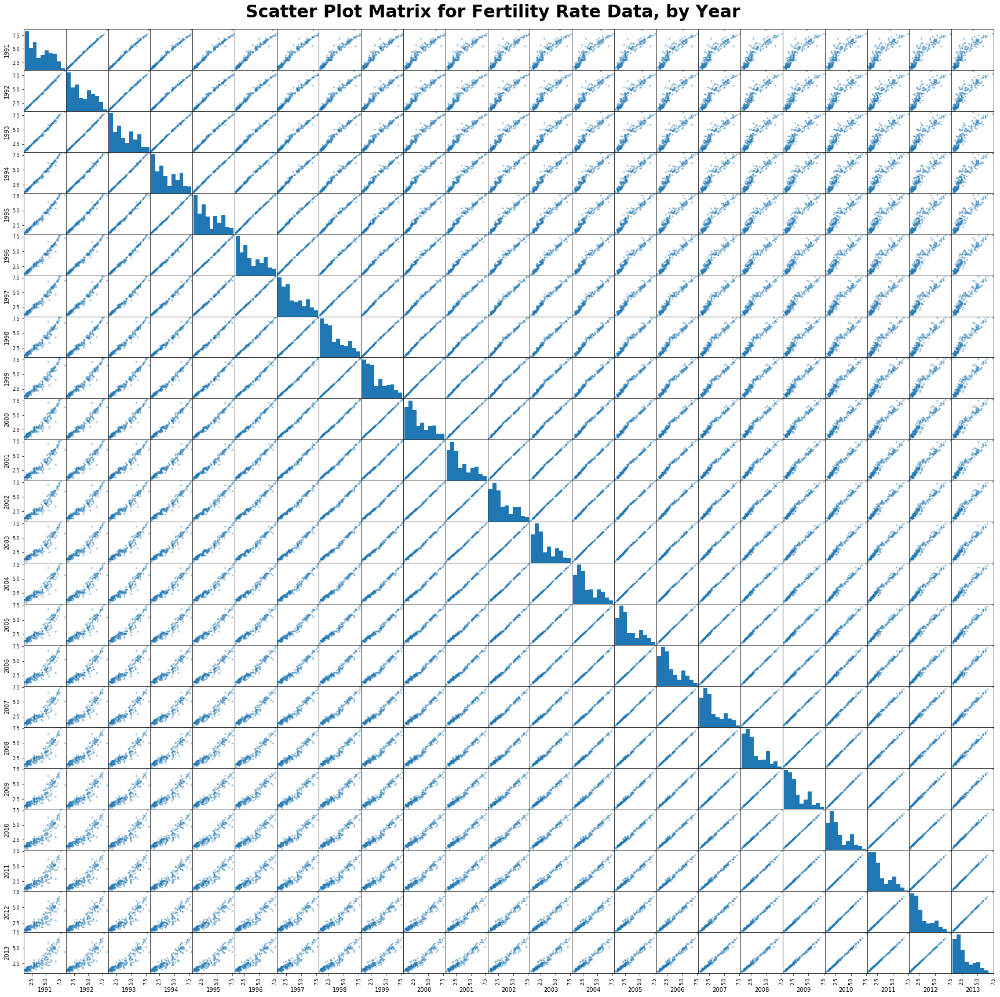

In [116]:
plot_scatters([all_dfs[0]], [stats_titles[0]])

The histograms for the fertility rate data show a positive skew. There is a very high positive correlation between the years, based on the scatter plots.

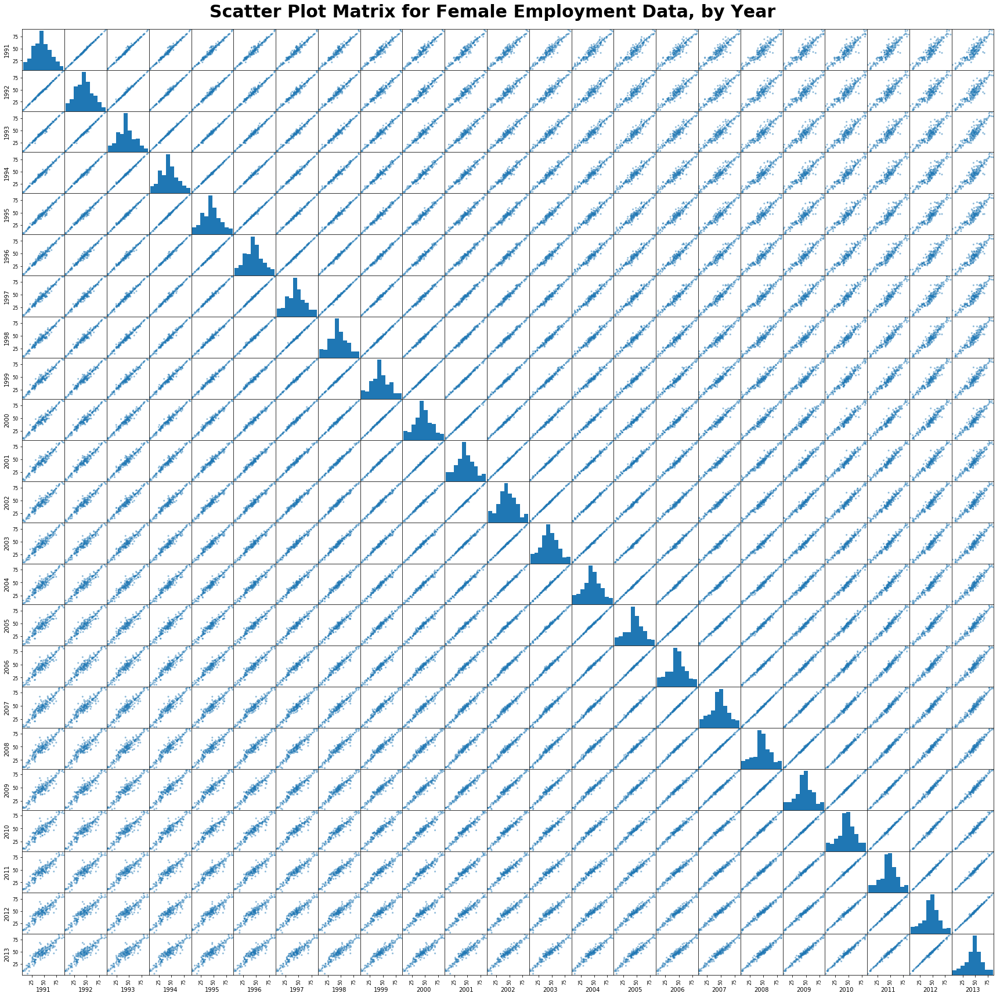

In [117]:
plot_scatters([all_dfs[1]], [stats_titles[1]])

The histograms for the total female employment rate data show a symmetrical, likely normal, distribution for all years. We also see a very high positive correlation between all years.

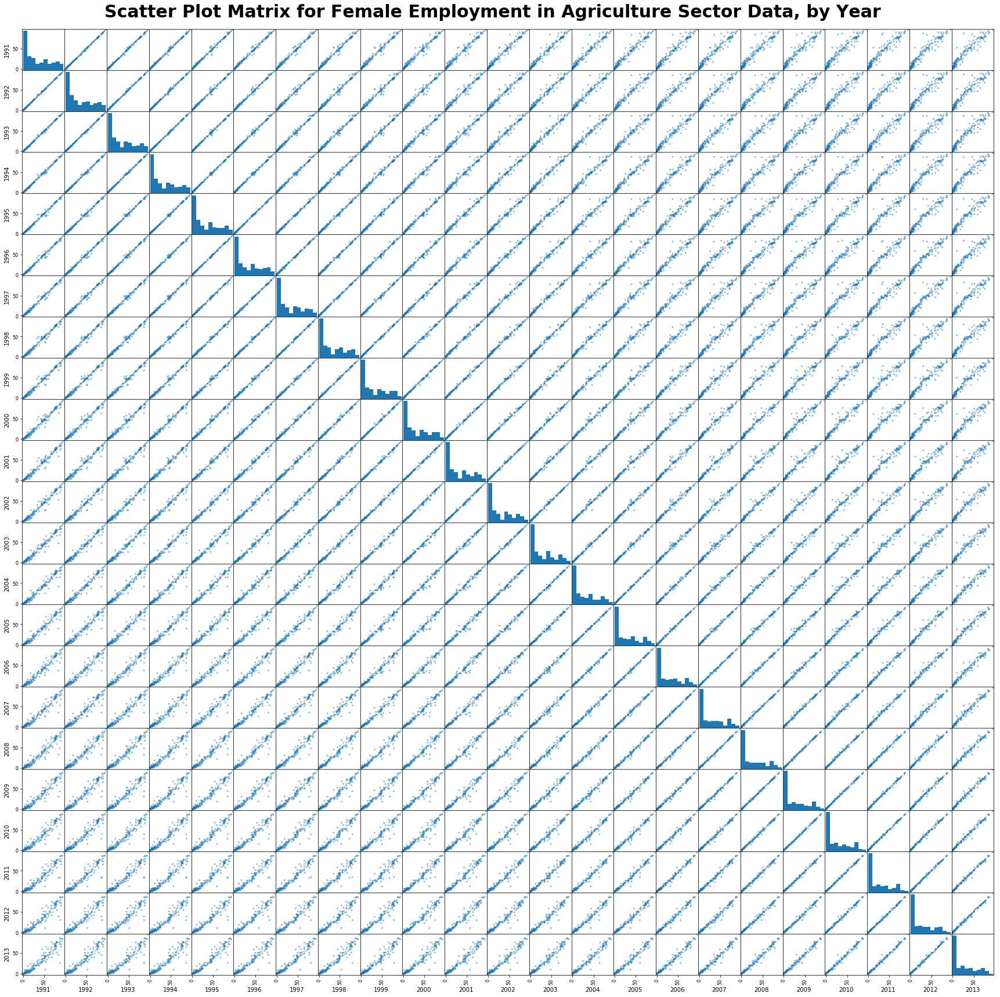

In [118]:
plot_scatters([all_dfs[2]], [stats_titles[2]])

The histograms for female employment rate in the agriculture sector both show a positive skew. All years in the period also show a very high positive correlation to each other.

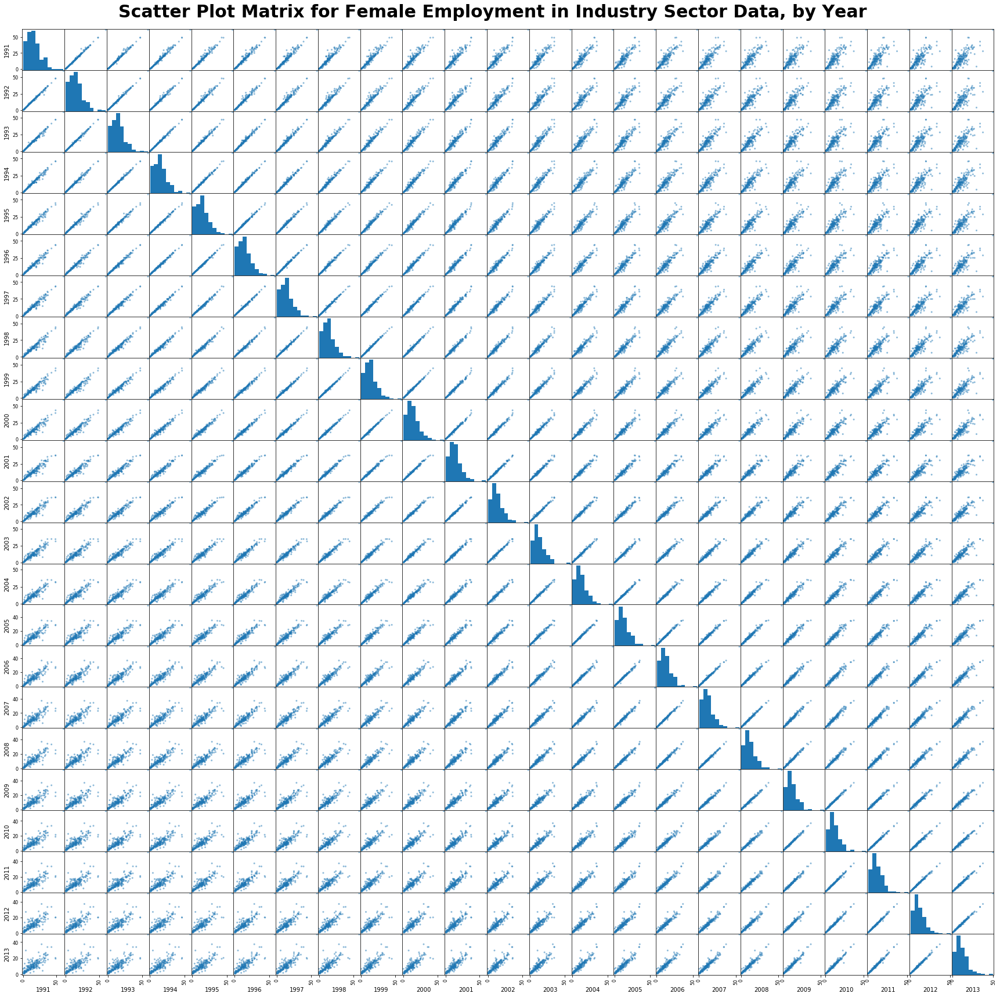

In [119]:
plot_scatters([all_dfs[3]], [stats_titles[3]])

The histograms for female employment rate in the industry sector both show a positive skew. The correlation between the years is positive, as seen in the scatter plots, and it is again very high.

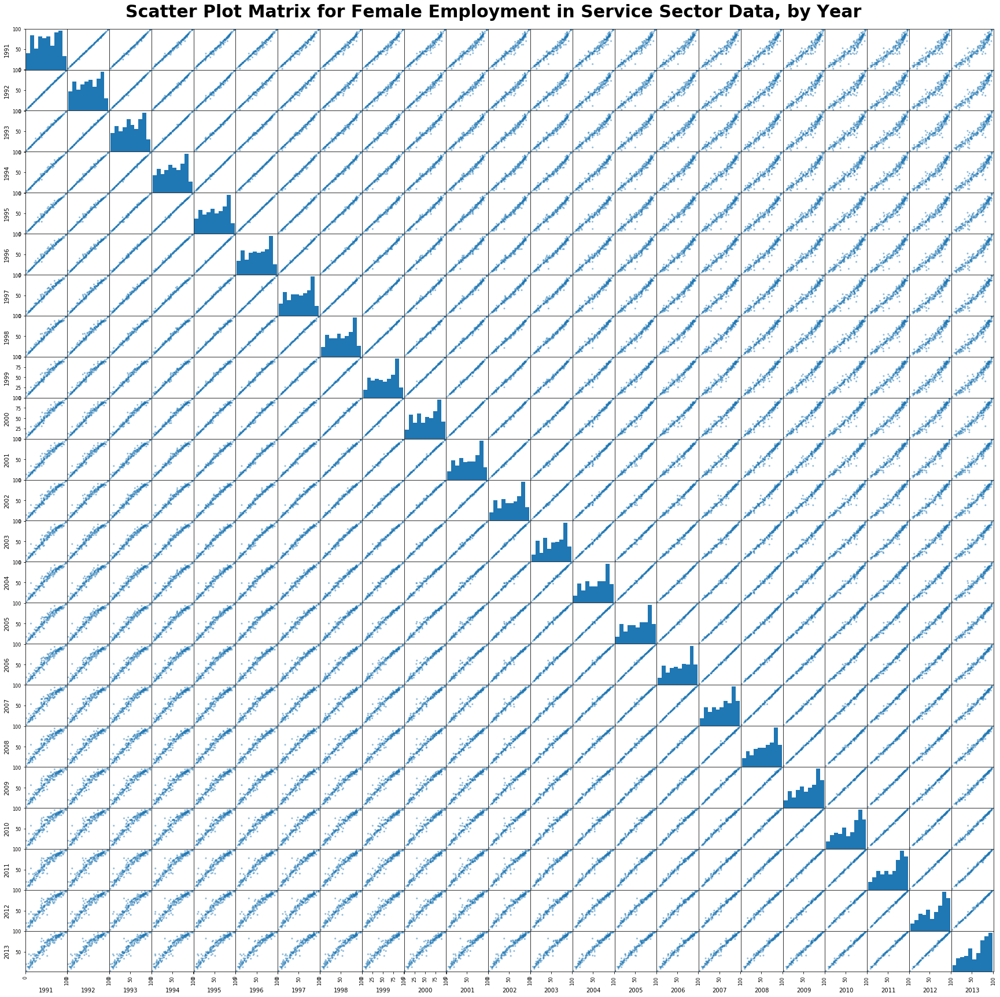

In [120]:
plot_scatters([all_dfs[4]], [stats_titles[4]])

The female employment rate data for the service sector show a negative skew. There is a very high positive correlation between the years over the whole period.

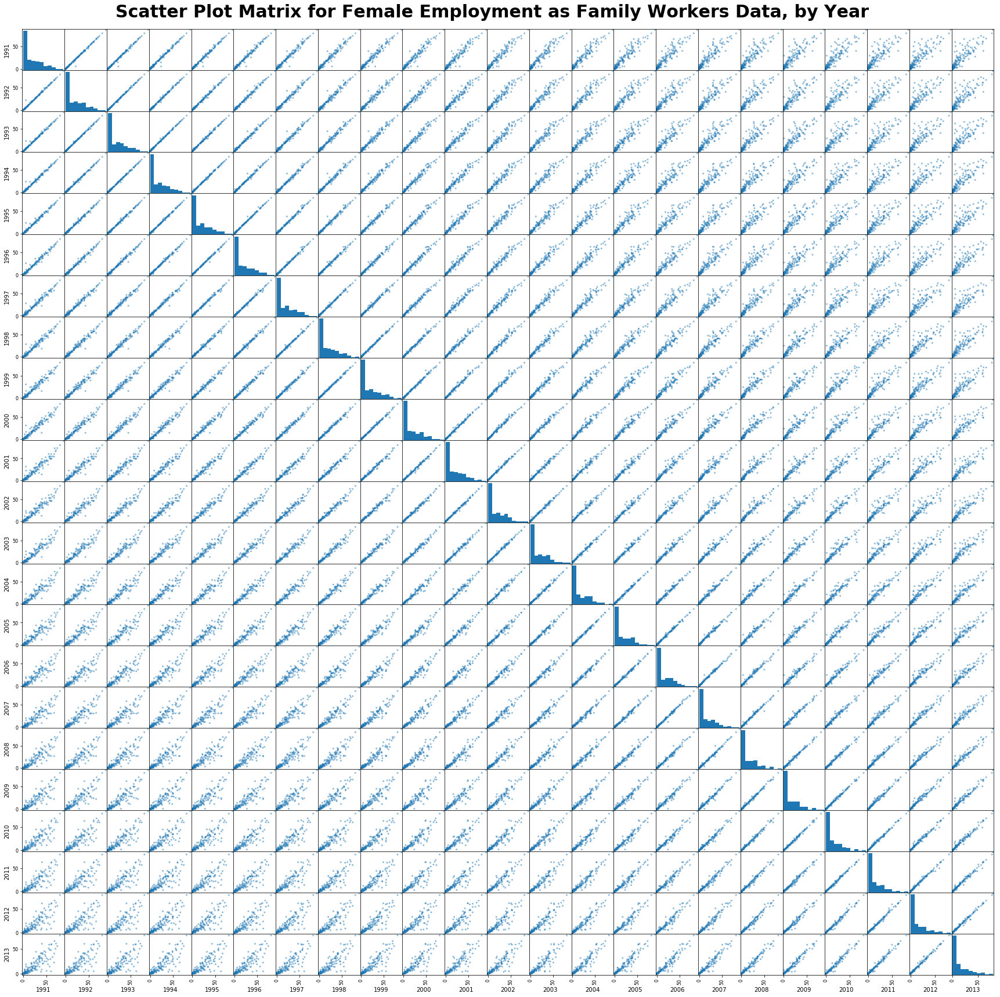

In [121]:
plot_scatters([all_dfs[5]], [stats_titles[5]])

The female employment rate for the family worker status shows a positive skew. The scatter plots show a very high positive correlation.

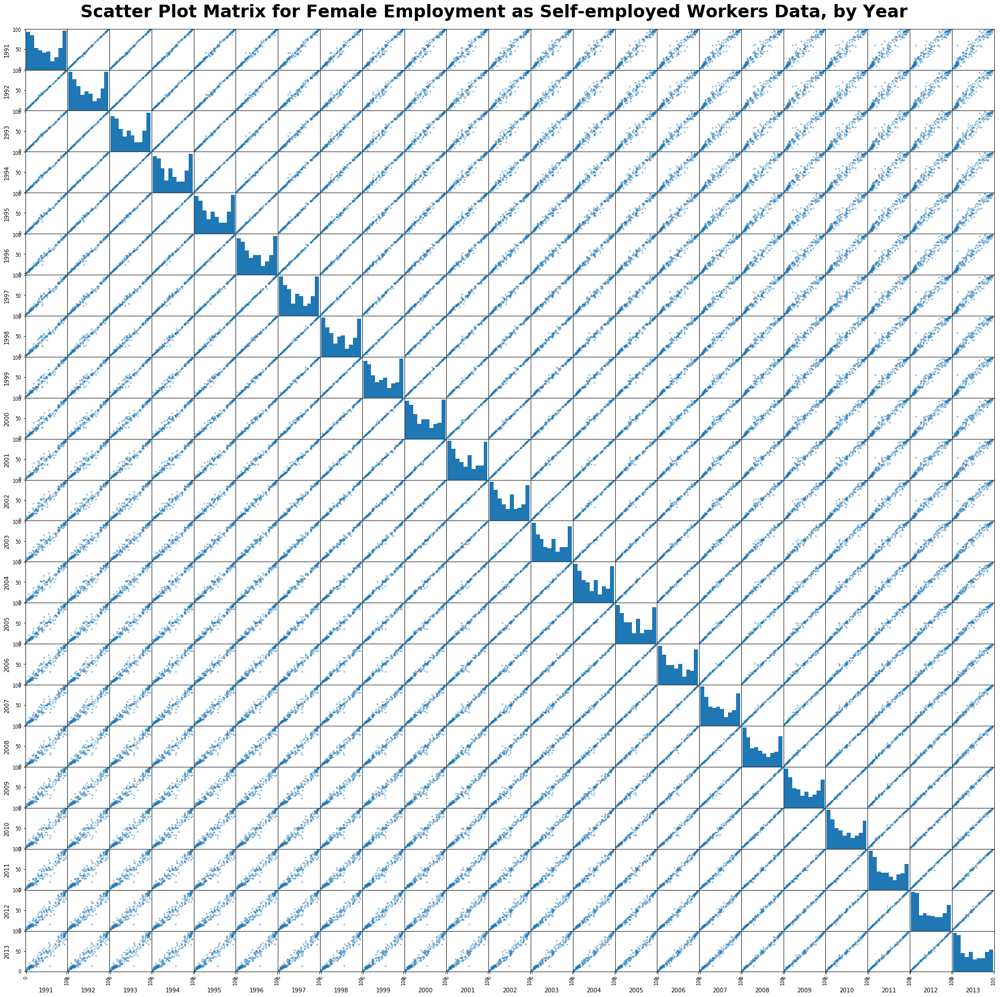

In [122]:
plot_scatters([all_dfs[6]], [stats_titles[6]])

The female employment rate for self-employed status shows possibly bimodal distributions, some of which have a stark positive skew. There is also very high positive correlation between the years.

The patterns in the spreads of the scatter plots for all our indicators suggest that each year has highest correlation to the years nearest to it in either direction, and even though the correlation between any two years decreases slightly as the years get further apart, the differences are so small that the correlation remains very high. This can be seen by looking at the correlation between the two years at the extreme ends of our period of study, 1991 and 2013, for all indicators. Therefore, it is safe to say that any of the years in the period is representative of the movement of the indicator across all other years for all countries.

We verify this conclusion by looking at heatmaps of correlation matrices, one for each dataframe. We will annotate each heatmap with the exact values, to two decimal places, of each correlation.

We start by defining a cutsom function to plot the correlation matrix heatmaps for our dataframes with the desired parameters and formatting.

In [127]:
def plot_corr_heatmaps(df_list, heatmap_title_list):
    '''
    The length of the two input arguments to this function must be the same.
    
    This function takes a list of dataframes and a list of plot titles,
    and plots correlation matrix heatmaps for each dataframe.
    '''
    for df, title in zip(df_list, heatmap_title_list):
        plt.figure(figsize = (15, 10))
        sns.heatmap(df.corr(), annot = True, cmap = "PiYG")
        plt.title("Correlation Matrix Heatmap for {} Data, by Year".format(title))
        plt.show()

We now plot the heatmap for our first dataframe.

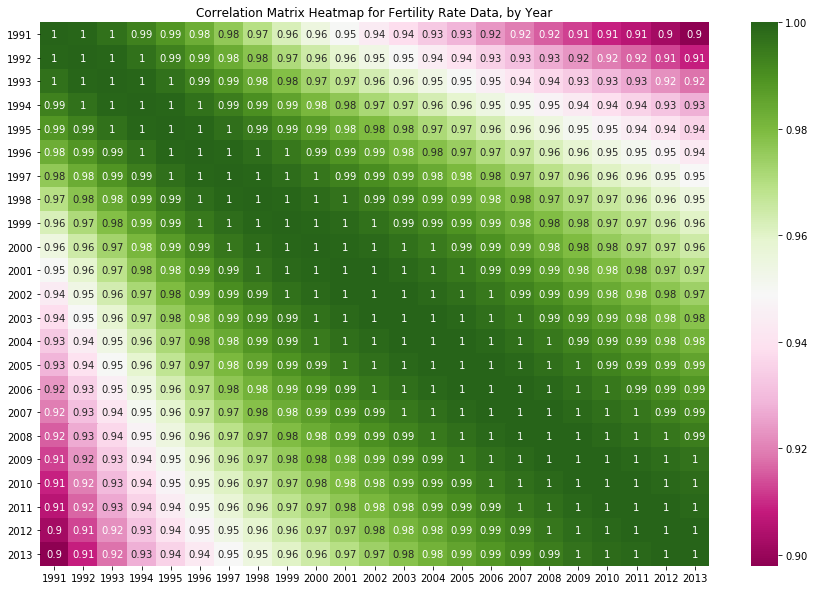

In [129]:
plot_corr_heatmaps([all_dfs[0]], [stats_titles[0]])

The heatmap shows that each year has a perfect positive correlation with the 4 or so years closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.9, which is very high.

We plot the heatmap for the next dataframe.

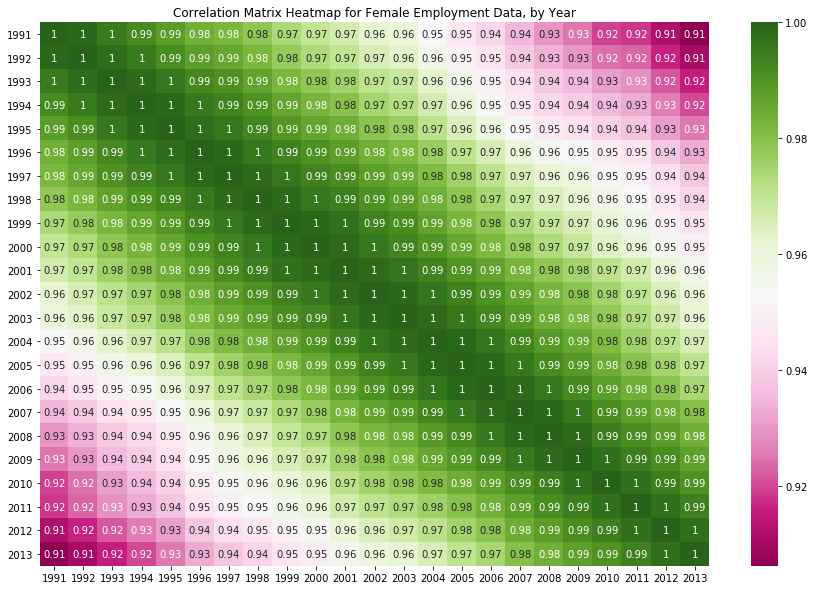

In [130]:
plot_corr_heatmaps([all_dfs[1]], [stats_titles[1]])

The heatmap shows that each year has a perfect positive correlation with the 2 or so years closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.91, which is very high.

We plot the heatmap for the next dataframe.

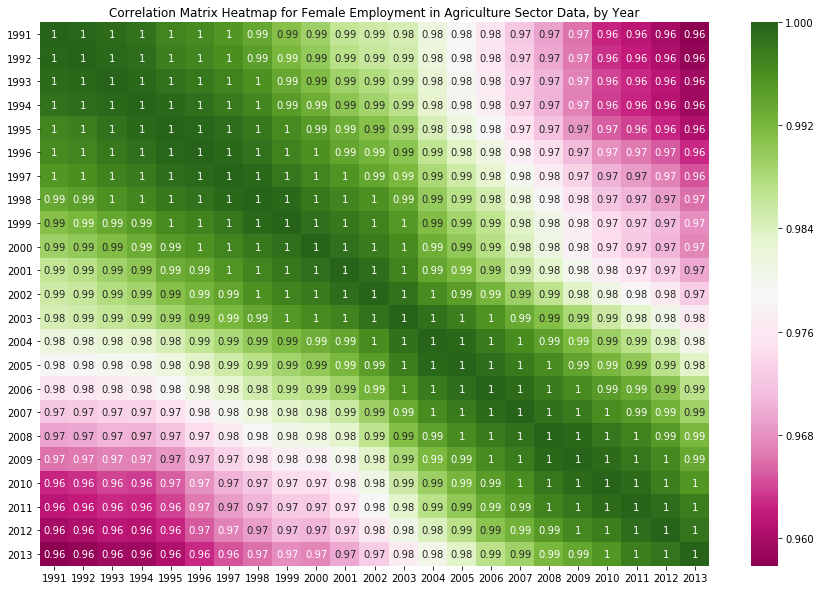

In [131]:
plot_corr_heatmaps([all_dfs[2]], [stats_titles[2]])

The heatmap shows that each year has a perfect positive correlation with the 3 or so years closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.96, which is very high.

We plot the heatmap for the next dataframe.

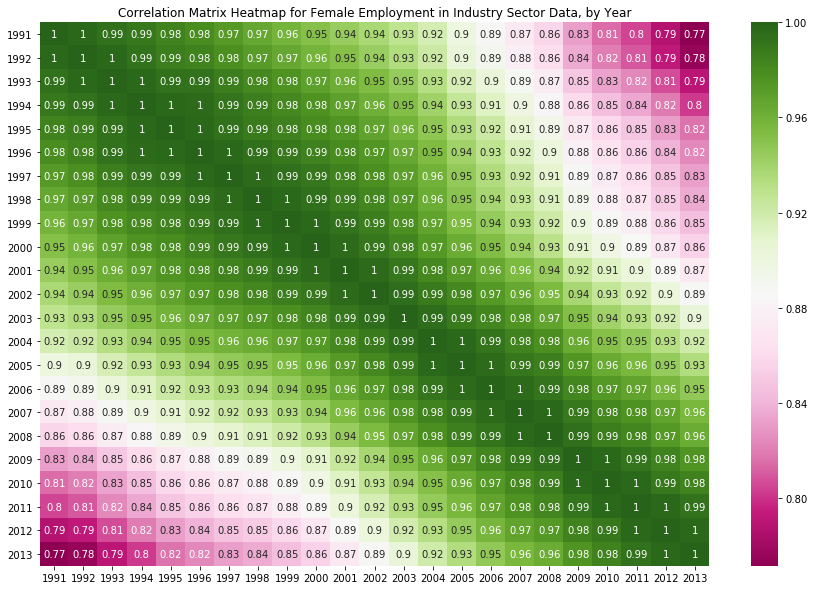

In [132]:
plot_corr_heatmaps([all_dfs[3]], [stats_titles[3]])

The heatmap shows that each year has a perfect positive correlation with the each year closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.77, which is fairly high.

We plot the heatmap for the next dataframe.

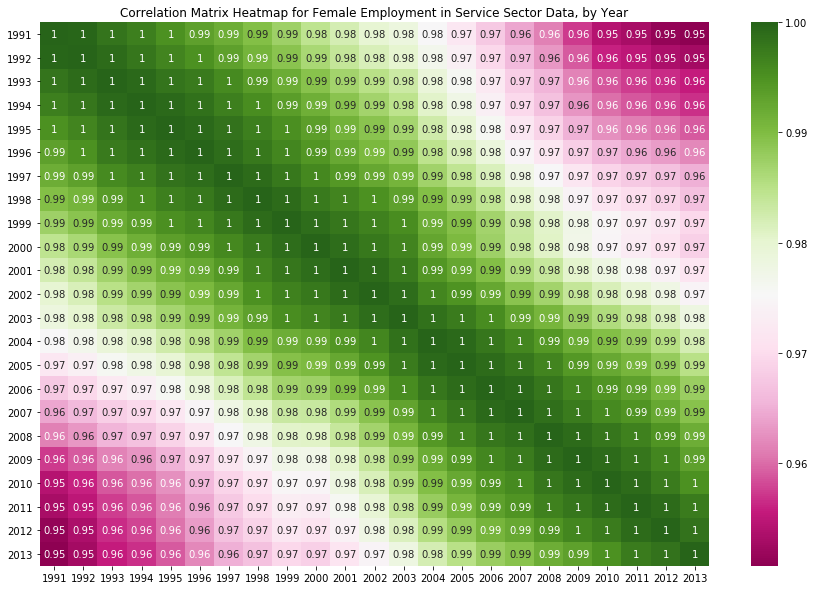

In [133]:
plot_corr_heatmaps([all_dfs[4]], [stats_titles[4]])

The heatmap shows that each year has a perfect positive correlation with the 3 or so years closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.95, which is very high.

We plot the heatmap for the next dataframe.

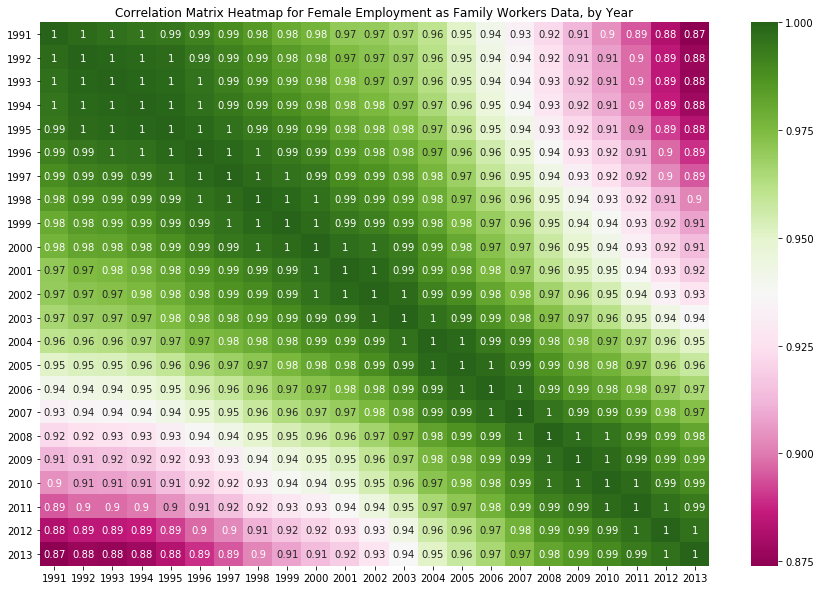

In [134]:
plot_corr_heatmaps([all_dfs[5]], [stats_titles[5]])

The heatmap shows that each year has a perfect positive correlation with each year closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.87, which is very high.

We plot the heatmap for the next dataframe.

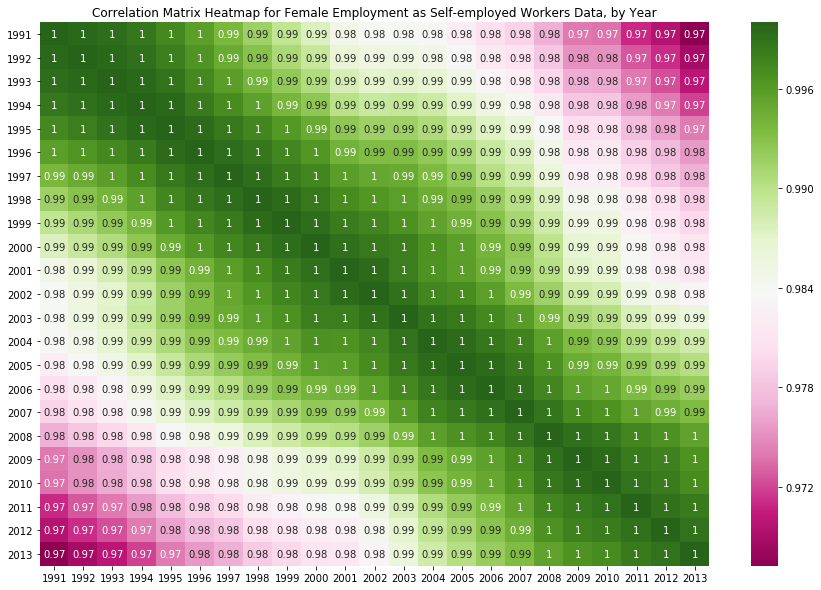

In [135]:
plot_corr_heatmaps([all_dfs[6]], [stats_titles[6]])

The heatmap shows that each year has a perfect positive correlation with the 4 or so years closest to it in either direction. The lowest value, for the correlation between 1991 and 2013, is 0.97, which is very high.

The correlation matrix heatmaps for our indicators support the initial observations we made visually from the scatter plots above. Even the very lowest values still represent high positive correlation. This confirms that there is high correlation across the years in the entire period. Based on these results. we tentatively select the latest year in the period to focus our analysis on, 2013.

We are now certain our chosen year is representative of the movement of the data for all indicators, across all countries, over the entire 23 year period. We now need to check, for each indicator, whether the values of the data for the year 2013 are representative of the values of the data across the entire 23 year period, for all the countries represented in our data.

To do this, we would like to compare the values of the data for the year 2013 against the values of the average aross the period, for each country, and for each indicator.

We first create dataframes that have the countries as columns and the years as rows, by reindexing and transposing our current dataframes. For each dataframe, we make the country column the new index, transpose the reindexed dataframe, and assign the result to a new variable

In [124]:
transposed_fertility = df_fertility.set_index("country").transpose()
transposed_employment = df_employment.set_index("country").transpose()
transposed_agric = df_agric.set_index("country").transpose()
transposed_industry = df_industry.set_index("country").transpose()
transposed_service = df_service.set_index("country").transpose()
transposed_family = df_family.set_index("country").transpose()
transposed_self_employed = df_self_employed.set_index("country").transpose()

We now need to determine which computation of "average" as used in the previous paragraph above is most suitable for our use case. The median is a more appropriate measure of central tendency for data with a skewed ditribution. The mean is more appropriate for data with a normal distribution. We would like to check which category our data fall into by looking at the distributions of the new transposed dataframes for each indicator.

We could start by plotting histograms of the data, and do a visual inspection of the plots for each indicator to see what that yields. However, we have 189 countries per dataframe, and across 7 indicators that would result in over a thousand histogram plots to analyse. This is an unwieldy volume to accurately inspect visually to a level of thoroughness that warrants a firm conclusion. Therefore, we will instead programmatically compute the skewness for each country for each indicator.

A skewness between -0.5 and 0.5 indicates that the distribution is almost symmetrical. We will extract a count, for each indicator, of how many countries show symmetrical distribution based on the skewness values. The proportion of countries for each indicator that shows a symmetrical distribution will determine which measure of central tendency we go on to use.

The `for` loop below uses the `skew()` function from Pandas, iterating through a list of the transposed dataframes. The result from this function is as long as the number of columns in the dataframe, 189. This is too long and cumbersome to print, and will return all levels of skewnwss, without directly giving us the actual information or final result we require. Thus, we will use a mask to slice from the output of the function only the values that show symmetry, i.e. have an absolute value of 0.5 or less, and then we will print out the total number of countries meeting that criterion for each indicator.

In [126]:
# List to hold the transposed dataframes for use in a loop
transposed_dfs = [transposed_fertility, transposed_employment, transposed_agric, transposed_industry,
                  transposed_service, transposed_family, transposed_self_employed]

print("NUMBER OF COUNTRIES, FOR EACH INDICATOR, WITH SKEWNESS VALUE BETWEEN -0.5 AND 0.5:\n")
for df, title in zip(transposed_dfs, stats_titles):
    print(title)
    print(df.skew(axis = 0)[df.skew(axis = 0).abs() <= 0.5].value_counts().sum())
    print()

NUMBER OF COUNTRIES, FOR EACH INDICATOR, WITH SKEWNESS VALUE BETWEEN -0.5 AND 0.5:

Fertility Rate
103

Female Employment
97

Female Employment in Agriculture Sector
94

Female Employment in Industry Sector
107

Female Employment in Service Sector
124

Female Employment as Family Workers
103

Female Employment as Self-employed Workers
91



We find that almost all the indicators have roughly an even split between countries which have a symmetrical distribution and countries which don't. As such, we will make our comparisons using both the median and the mean in our visualizations, to adequately cater for both kinds of distributions present in our data, and for completeness.

For each indicator, we now compare the values for the year 2013 against both the median and the mean of the values since 1991, for each of our 189 countries. We make use of line plots for this comparison, and define a custom function for efficiency.

In [136]:
def plot_comparison_lines(df_list, lines_titles):
    '''
    This function takes a list of dataframes and a list of plot titles, and for
    each dataframe, plots the line graphs for the mean for 1991-2013, the median
    for 1991-2013, and the 2013 values
    '''
    for df, title in zip(df_list, lines_titles):
        plt.figure(figsize = (35, 35))
        # Plot the median value of the data for the dataframe
        plt.plot(df.median(axis = 0), color = "blue", label = "Median of 1991-2013 Data");
        # Plot the mean value of the data for the dataframe
        plt.plot(df.mean(axis = 0), color = "c", label = "Mean of 1991-2013 Data");
        # Plot the data in the last column, which is the 2013 column
        plt.plot(df.iloc[-1,:], color = "m", label = "2013 Data");
        plt.xticks(rotation = 90);
        plt.yticks(size = 12)
        plt.title("{}: Comparison between 2013 data and mean and median of 1991-2013 data".format(title), size = 30)
        plt.legend(fontsize = "xx-large")

We use our custom function to plot the first set of line plots.

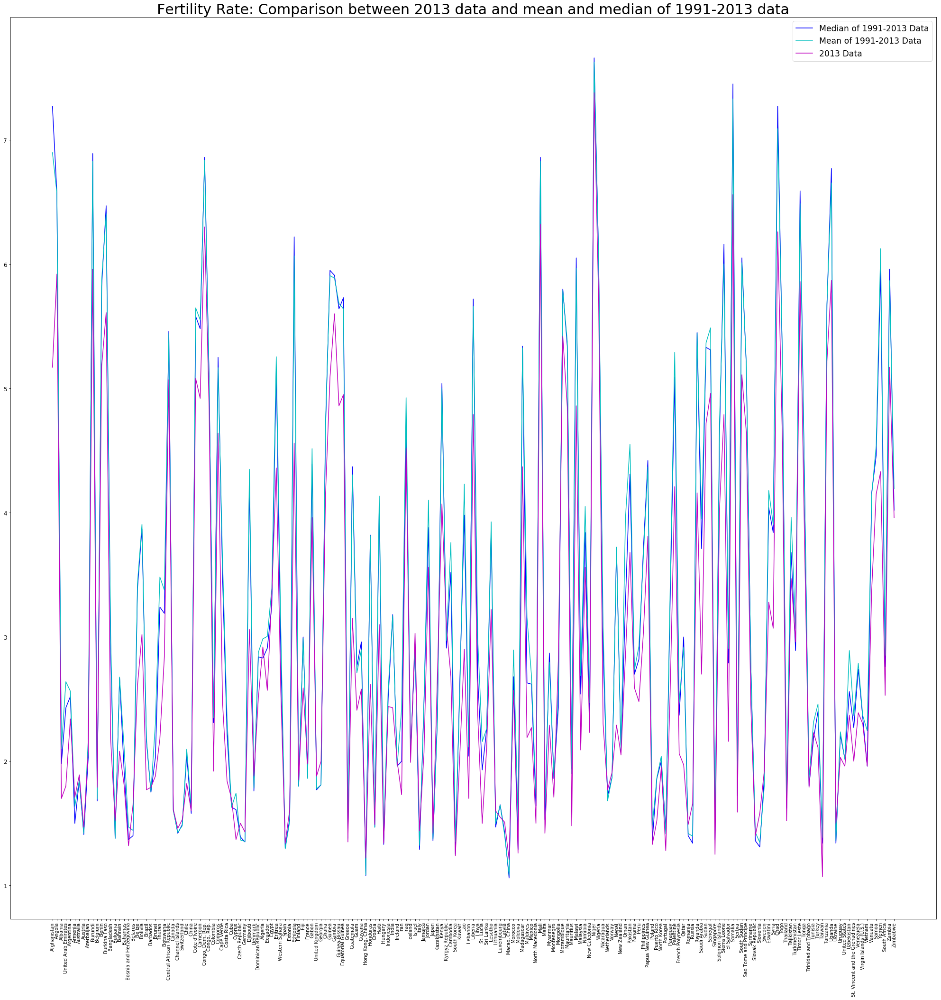

In [138]:
plot_comparison_lines([transposed_dfs[0]], [stats_titles[0]])

The line plots for fertility rate data show that the values of the median and mean values for each country are very similar, with the graphs superimposed onto each other for many of the values. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

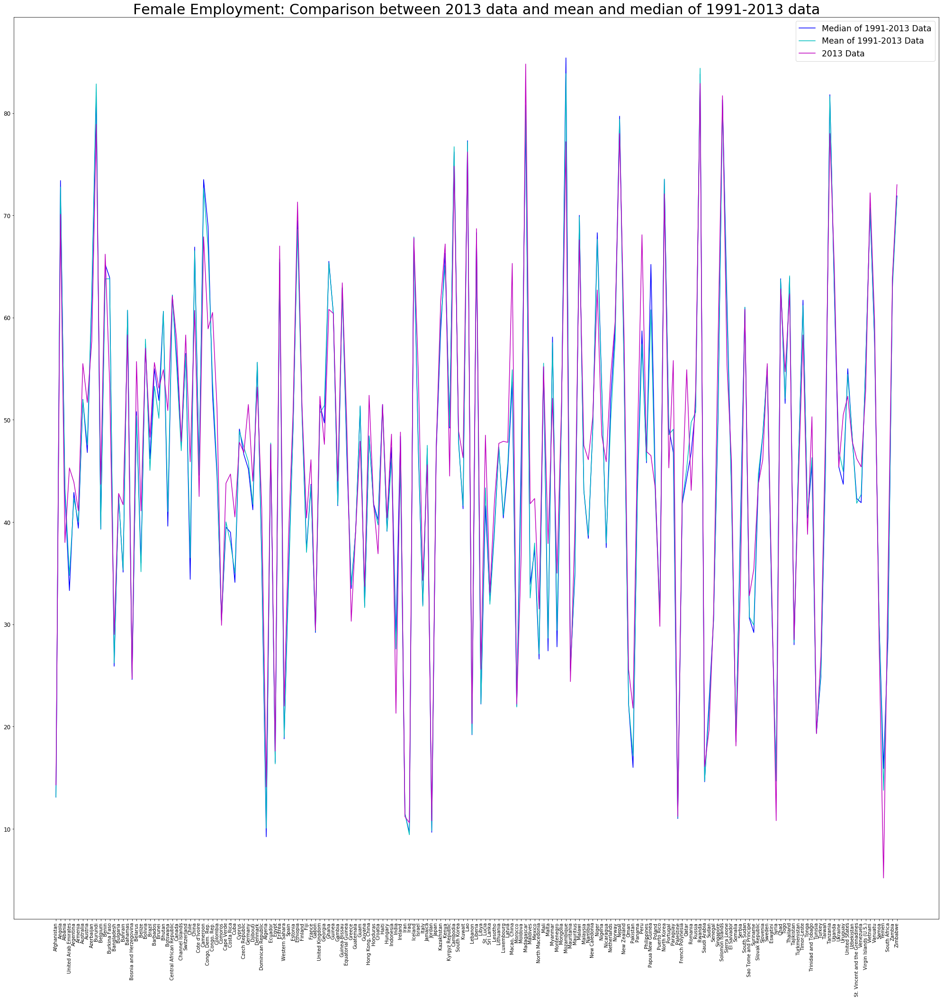

In [145]:
plot_comparison_lines([transposed_dfs[1]], [stats_titles[1]])

The line plots for total female employment rate data show that the values of the median and mean values for each country are very similar across the countries. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

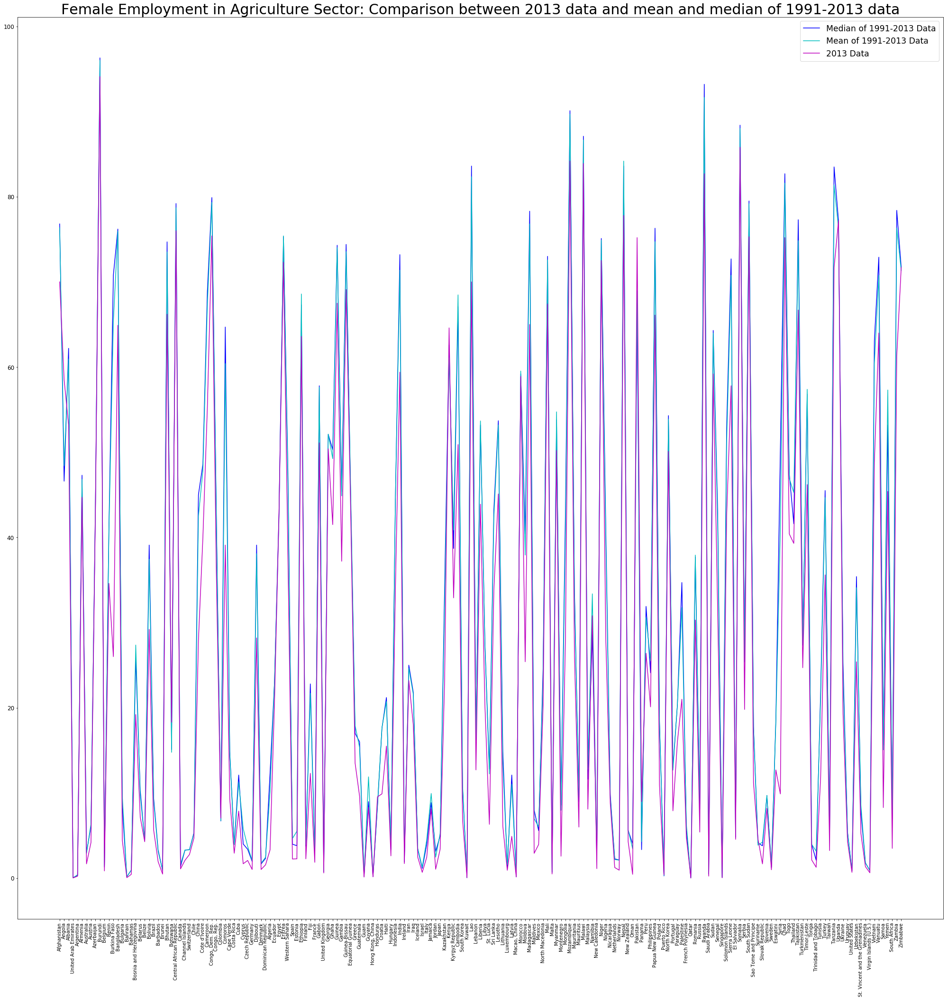

In [146]:
plot_comparison_lines([transposed_dfs[2]], [stats_titles[2]])

The line plots for fertility rate data show that the values of the median and mean values for each country are very similar, with the graphs almost indistinguishable from each other for many of the values. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

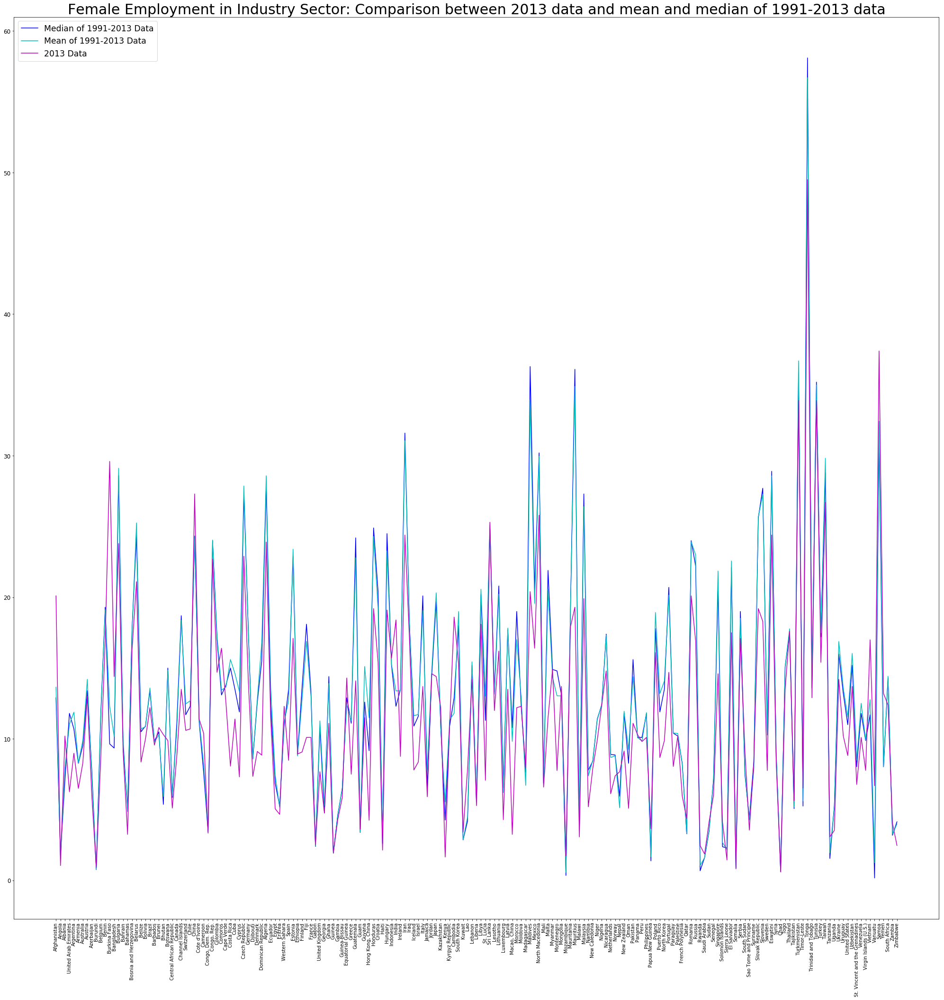

In [147]:
plot_comparison_lines([transposed_dfs[3]], [stats_titles[3]])

The line plots for fertility rate data show that the values of the median and mean values for each country are very similar to each other consistently. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

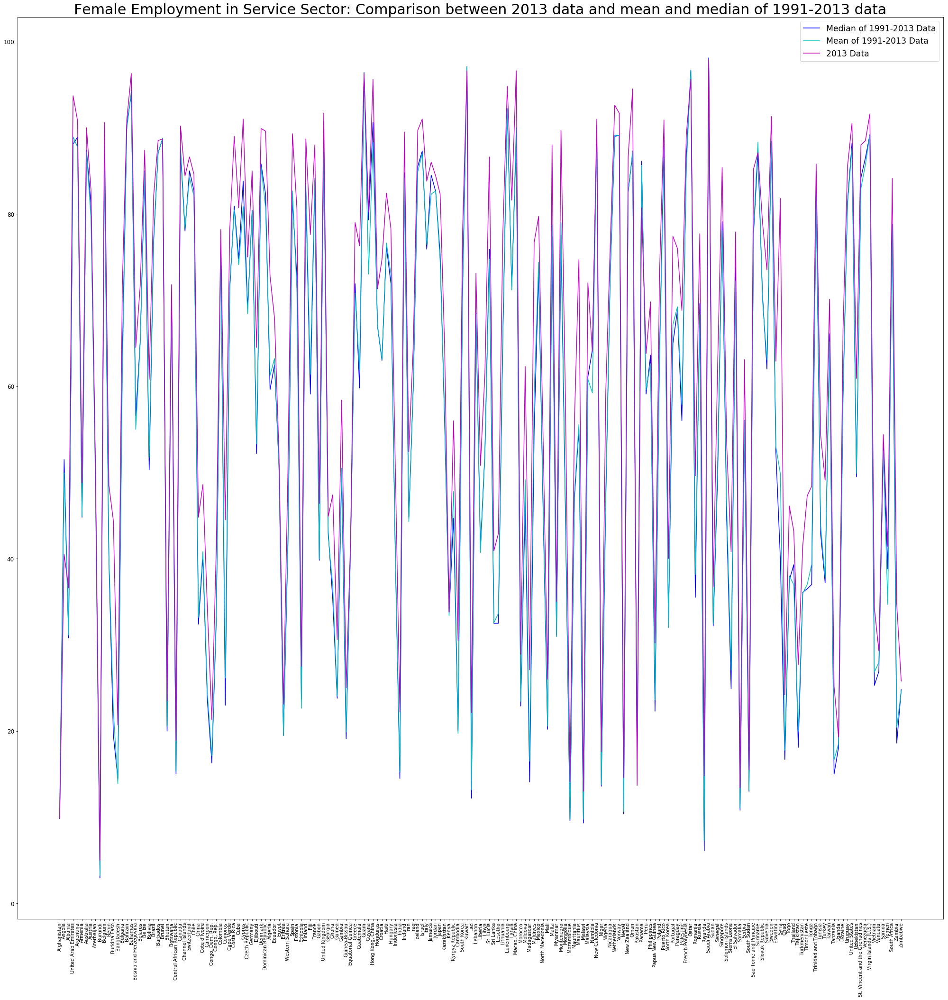

In [148]:
plot_comparison_lines([transposed_dfs[4]], [stats_titles[4]])

The line plots for fertility rate data show that the values of the median and mean values for each country are very similar along the length of the axis. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

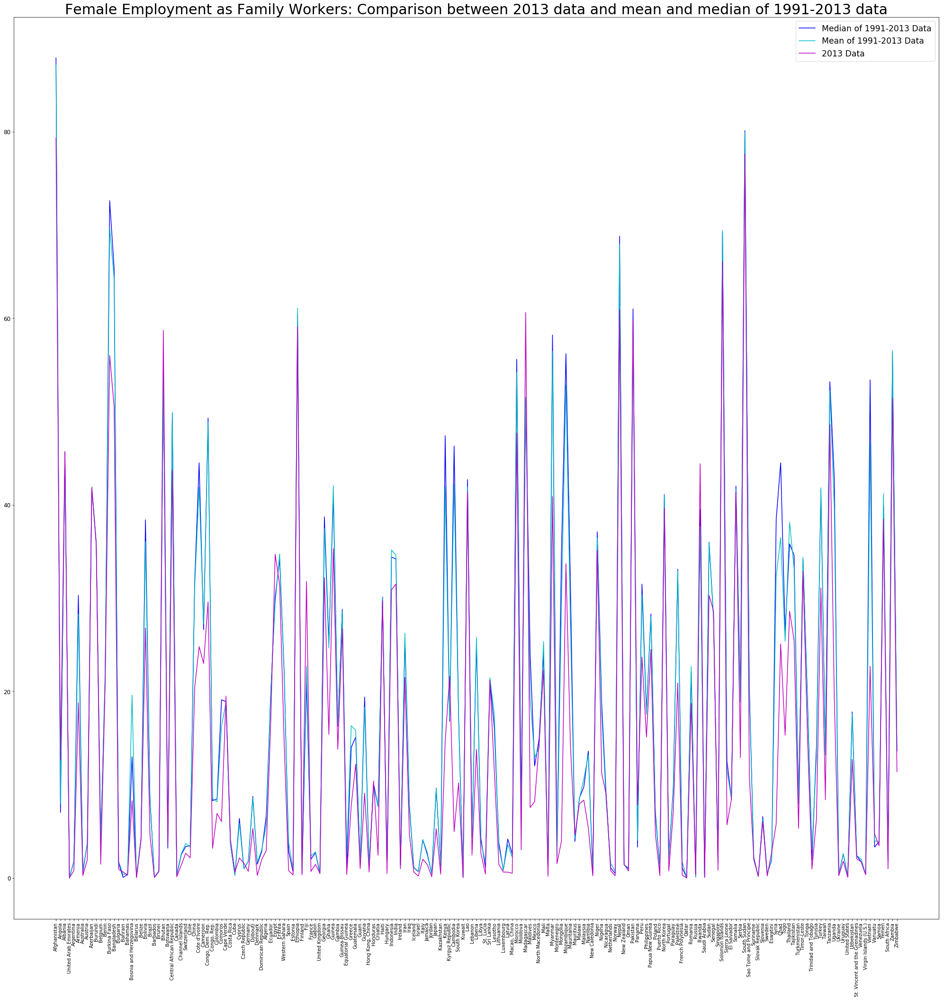

In [149]:
plot_comparison_lines([transposed_dfs[5]], [stats_titles[5]])

The line plots for fertility rate data show that the values of the median and mean values for each country are again very similar. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

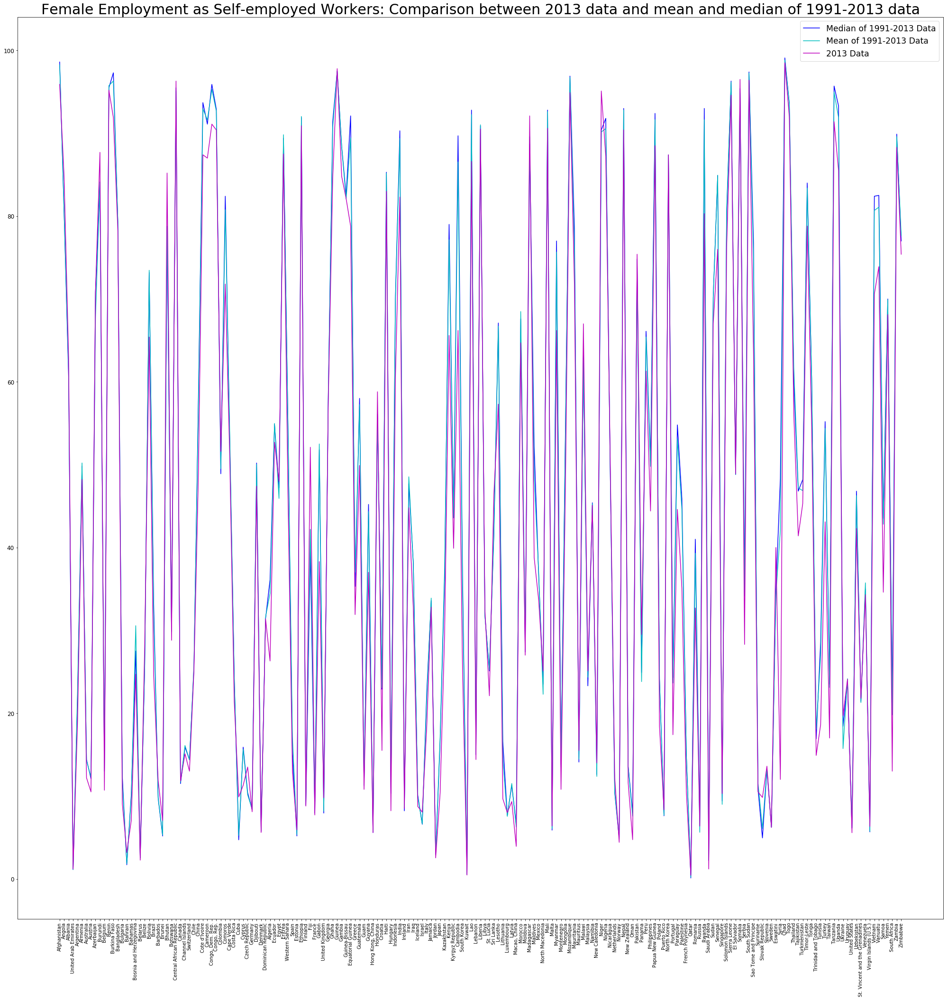

In [150]:
plot_comparison_lines([transposed_dfs[6]], [stats_titles[6]])

For our final dataframe, once more the line plots for fertility rate data show that the values of the median and mean values for each country are very similar. Additionally, the values for 2013 alone are not very dissimilar to either the mean or the median across the entire period.

Based on our observations showing consistency for all the line plots, we conclude that the values for 2013 are represeentative of the values for the overall period under study. We will now use the values for this year to construct our new dataframe for analysis.

We extract the 2013 column from each of our 7 dataframes holding data on our indicators, and assign the countries as the index to this new dataframe.

In [151]:
# The column names of our new dataframe
final_columns = ["Fertility", "Employment", "Agriculture", "Industry", "Service", "Family", "Self_employed"]
# The index of our new dataframe, the list of countries
final_index = df_fertility["country"]
# Creating a new dataframe, with the required dimensions, column names and index
df_2013 = pd.DataFrame(index = final_index, columns = final_columns)

# Loop iterates through the new dataframe, populating it with the appropriate column data
for i in np.arange(len(df_2013.columns)):
    # For the column of each indicator in the new dataframe, the 2013 column data of the
    # corresponding dataframe for the indicator is retrieved and assigned to the column
    df_2013[df_2013.columns[i]] = all_dfs[i]["2013"].values

We check the structure if our new dataframe to ensure it has been populated correctly and is as desired.

In [152]:
df_2013.shape

(189, 7)

In [153]:
df_2013.head()

,Fertility,Employment,Agriculture,Industry,Service,Family,Self_employed
country,,,,,,,
Afghanistan,5.17,14.3,70.0000,20.10,9.9,79.3000,95.90
Angola,5.92,70.1,58.5000,1.05,40.5,12.7000,84.70
Albania,1.70,38.0,53.2000,10.20,36.6,45.7000,62.90
United Arab Emirates,1.80,45.3,0.0154,6.26,93.7,0.0146,1.19
Argentina,2.34,43.9,0.2270,8.98,90.8,0.7910,19.10


In [154]:
df_2013.tail()

,Fertility,Employment,Agriculture,Industry,Service,Family,Self_employed
country,,,,,,,
Samoa,4.15,28.40,8.28,37.40,54.4,3.460,34.6
Yemen,4.33,5.19,45.40,13.20,41.4,38.500,68.1
South Africa,2.53,34.50,3.49,12.40,84.1,0.981,13.0
Zambia,5.17,64.00,61.30,4.03,34.7,51.400,88.3
Zimbabwe,3.96,73.00,71.70,2.47,25.8,11.400,75.4


We check for null values in the new dataframe.

In [155]:
df_2013.isnull().sum()

Fertility        0
Employment       0
Agriculture      0
Industry         0
Service          0
Family           0
Self_employed    0
dtype: int64

There are no null values, and this is satisfactory. We also look at the descriptive statistics, histograms and skewness of the new dataframe. We use a custom function for this.

In [200]:
def plot_hists_stats_skewness(df, title):
    '''
    This function takes a dataframe and a single string that will be used
    for both the plot title and the x-axis label. The function shows
    descriptive statistics, a histogram plot, and skewess for the dataframe.
    '''
    display(df.describe())
    ax1 = df.hist();
    ax1.set_xlabel(title);
    ax1.set_ylabel("Number");
    ax1.set_title("{} for 2013".format(title));
    plt.show();
    print("Skewness: ", df.skew())

We use our custom function for the first column.

count    189.000000
mean       2.848995
std        1.432320
min        1.070000
25%        1.770000
50%        2.340000
75%        3.810000
max        7.380000
Name: Fertility, dtype: float64

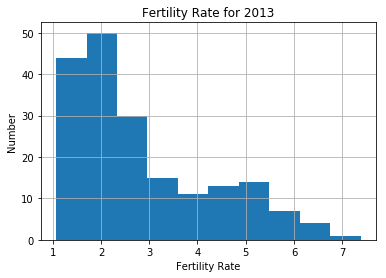

Skewness:  0.9842647209320079


In [190]:
plot_hists_stats_skewness(df_2013["Fertility"], stats_titles[0])

The count, minimum and maximum values are as we expect and have reasonable values. The distribution for fertility rate in the hoistogram has a distinct positive skew. This is confirmed by the high value of the skewness.

We look at the next column.

count    189.000000
mean      46.985132
std       15.880182
min        5.190000
25%       39.200000
50%       47.700000
75%       55.800000
max       84.800000
Name: Employment, dtype: float64

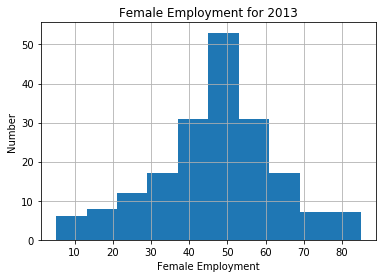

Skewness:  -0.23388238331900701


In [191]:
plot_hists_stats_skewness(df_2013["Employment"], stats_titles[1])

The count, minimum and maximum values are as we expect and have reasonable values. The data for total female employment rate have a distribution that is close to a normal distribution, with a slight leaning towards a negative skew. The value of the skewness supports this conclusion.

We look at the next column.

count    189.000000
mean      25.461409
std       26.320940
min        0.009970
25%        2.610000
50%       12.700000
75%       43.900000
max       94.100000
Name: Agriculture, dtype: float64

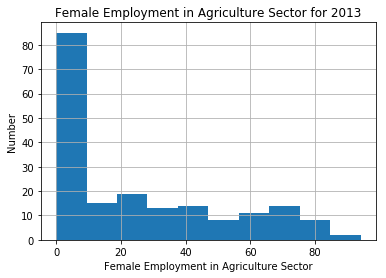

Skewness:  0.8197610760080623


In [192]:
plot_hists_stats_skewness(df_2013["Agriculture"], stats_titles[2])

The count, minimum and maximum values are as we expect and have reasonable values. The distribution for female employment rate in the agriculture sector has a positive skew. This is supported by another high value of skewness.

We move on to the next column.

count    189.000000
mean      11.503328
std        7.304000
min        0.593000
25%        6.590000
50%       10.100000
75%       14.800000
max       49.500000
Name: Industry, dtype: float64

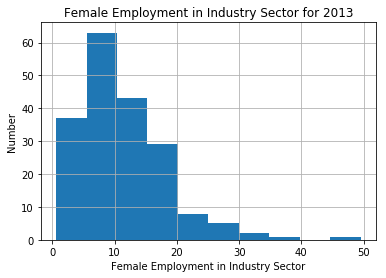

Skewness:  1.4924151789563096


In [193]:
plot_hists_stats_skewness(df_2013["Industry"], stats_titles[3])

The count, minimum and maximum values are as we expect and have reasonable values. The distribution for female employment rate in the industry sector each shows a distinct positive skew. The very high skewness value that is greater than 1 reflects the degree of the skew.

We look at the next column.

count    189.000000
mean      63.040688
std       25.205367
min        4.990000
25%       43.200000
50%       70.100000
75%       85.500000
max       97.900000
Name: Service, dtype: float64

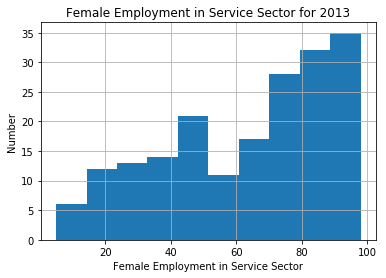

Skewness:  -0.5032827963985977


In [194]:
plot_hists_stats_skewness(df_2013["Service"], stats_titles[4])

The count, minimum and maximum values are as we expect and have reasonable values. The distribution for female employment rate in the service sector shows a negative skew, though the slope seems gradual. The skewness value is right on the edge between what is considered symmetrical and asymmetrical. It is possible that this distribution is bimodal.

We look at the next column.

count    189.000000
mean      14.295604
std       17.507193
min        0.009520
25%        0.966000
50%        6.050000
75%       22.700000
max       79.300000
Name: Family, dtype: float64

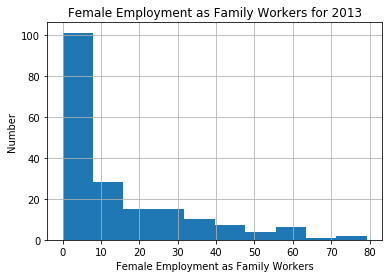

Skewness:  1.4947411704618372


In [195]:
plot_hists_stats_skewness(df_2013["Family"], stats_titles[5])

The count, minimum and maximum values are as we expect and have reasonable values. The distributions for female employment rate as family workersis another that has a distinct positive skew. This is confirmed by another very high skewnwss value.

We look at the final column.

count    189.000000
mean      42.571217
std       31.466568
min        0.437000
25%       12.000000
50%       35.100000
75%       71.600000
max       98.500000
Name: Self_employed, dtype: float64

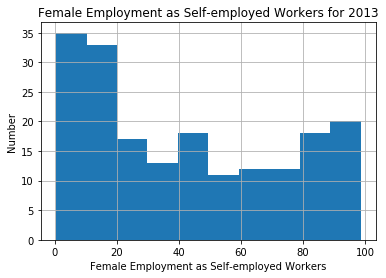

Skewness:  0.3572572881618144


In [196]:
plot_hists_stats_skewness(df_2013["Self_employed"], stats_titles[6])

The count, minimum and maximum values are as we expect and have reasonable values. The distribution for female employment as self-employed workers is symmetrical, but possibly bimodal. The skewness value indicates symmetry.

We now go on to address our research questions.

### Research Question 1: Do countries with higher fertility rate have higher or lower total female employment rate than those with lower fertility rate?

To find out whether the number of children per woman has any impact on the rate of female employment, we look at the correlation between fertility rate and total female employment rate.

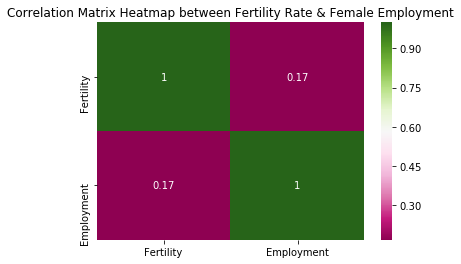

In [201]:
sns.heatmap(df_2013[["Fertility", "Employment"]].corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Fertility Rate & Female Employment");

There is a low positive correlation between the fertility rate and the total female employment rate.

We investigate further by splitting the data into two equal groups, the half of the countries with a fertility rate equal to or higher than the median fertility rate, and the other half of countries with a fertility rate lower than the median fertility rate. We will then assess these two groups separately to see whether there are any commonalities or relationships between them, in terms of female employment rate.

In [202]:
# Storing the median fertility rate
fertility_median = df_2013["Fertility"].median(axis = 0)
# Masks to use for slicing the dataframe into high fertility rate and low fertility rate groups
mask_high_fertility = df_2013["Fertility"] >= fertility_median
mask_low_fertility = df_2013["Fertility"] < fertility_median
# Using the masks, and storing the subsets in new variables
df_2013_high_fertility = df_2013[mask_high_fertility]
df_2013_low_fertility = df_2013[mask_low_fertility]

We first use a side-by-side line plot to visualize the female employment rate for the two groups. We define a custom function for this purpose.

In [203]:
def plot_side_by_side(df_high, df_low, title):
    '''
    This function takes in two dataframes, one for countries with higher fertility rate
    and the other for coutnries with low fertility rate, and then creates two line plots
    one for each dataframe, and on each of two adjacent sets of axes
    '''
    plt.figure(figsize = (35, 35));
    # Creating a subplot on the left and plotting for the high fertility group
    ax1 = plt.subplot(1, 2, 1);
    plt.plot(df_high, color = "blue", label = "High Fertility");
    plt.xticks(rotation = 90);
    plt.legend(fontsize = "xx-large");
    plt.ylabel("Female Employment Rate (%)", size = 18);
    # Creating a subplot on the right and plotting for the low fertility group
    ax2 = plt.subplot(122, sharey = ax1);
    plt.plot(df_low, color = "magenta", label = "Low Fertility");
    plt.xticks(rotation = 90);
    plt.legend(fontsize = "xx-large");
    plt.subplots_adjust(wspace = 0);
    plt.suptitle("Comparison of Female Employment{} between Countries with High Fertility and Low Fertility".format(title), size = 30, y = 0.9);

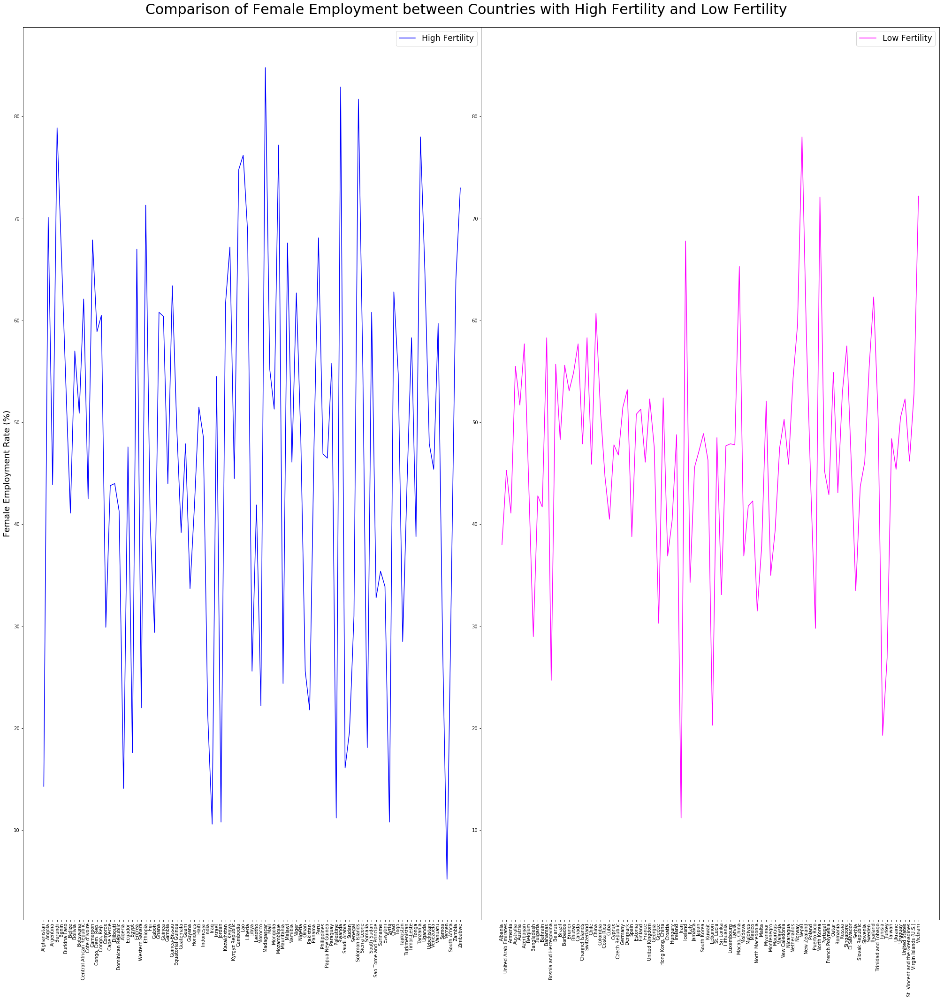

In [204]:
# Using our custom function for the plots
plot_side_by_side(df_2013_high_fertility["Employment"], df_2013_low_fertility["Employment"], "")

From the graphs, we can see that there is variability in the female employment rate for each group. This could explain the low correlation we saw for the combined data above, if there isn't a similar level of variability in the fertility rate itself across countries. We also see that, whilst the two groups seem to range between similar values of employment rate, there seems to be more variability in the values for the countries with higher fertility than for those with lower fertility.

Next, we look at how the descriptive statistics for countries with higher fertility rate differ (or do not) from those of countries with lower fertility rate. We will also compute the coefficients of variation (CV), calculated as a ratio of the standard deviation to the mean, which allow us to make comparisons of the levels of variability for each of the indicators for each of our groups.

In [205]:
# Storing descriptive statistics in a variable, and then displaying them
high_employment_stats = df_2013_high_fertility[["Fertility", "Employment"]].describe()
display(high_employment_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
high_employment_CV = high_employment_stats.loc["std"] / high_employment_stats.loc["mean"]
print("Coefficients of Variation:")
display(high_employment_CV)

,Fertility,Employment
count,95.000000,95.000000
mean,3.943263,47.007263
std,1.254652,19.560642
min,2.340000,5.190000
25%,2.755000,33.250000
50%,3.810000,47.900000
75%,4.890000,61.850000
max,7.380000,84.800000


Coefficients of Variation:


Fertility     0.318176
Employment    0.416120
dtype: float64

In [206]:
# Storing descriptive statistics in a variable, and then displaying them
low_employment_stats = df_2013_low_fertility[["Fertility", "Employment"]].describe()
display(low_employment_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
low_employment_CV = low_employment_stats.loc["std"] / low_employment_stats.loc["mean"]
print("Coefficients of Variation:")
display(low_employment_CV)

,Fertility,Employment
count,94.000000,94.000000
mean,1.743085,46.962766
std,0.311065,11.092776
min,1.070000,11.200000
25%,1.500000,41.925000
50%,1.750000,47.650000
75%,1.997500,52.875000
max,2.300000,78.000000


Coefficients of Variation:


Fertility     0.178456
Employment    0.236204
dtype: float64

We find that the mean and median for the two groups are almost exactly the same. There is more variability, however, in the female employment rate of countries with higher fertility rate than those with lower fertility rate, evidenced by the higher standard deviation, and almost twice the CV, for that group. We also see from the *min* and *max* values of each group that the higher fertility group has a wider range of values for female employment rate than the lower fertility group.

Next, we check for the correlation with fertility rate for each group separately.

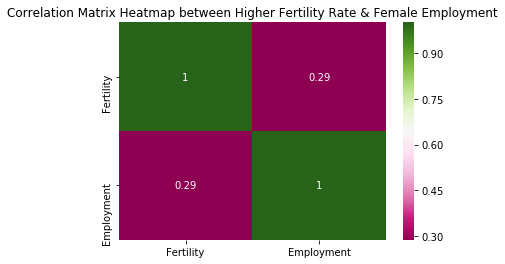

In [207]:
sns.heatmap(df_2013_high_fertility[["Fertility", "Employment"]].corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Higher Fertility Rate & Female Employment");

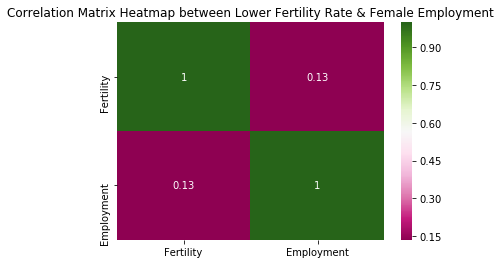

In [208]:
sns.heatmap(df_2013_low_fertility[["Fertility", "Employment"]].corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Lower Fertility Rate & Female Employment");

We find that countries with higher fertility rate have a higher positive correlation with female employment than countries with lower fertility rate. However, the correlation is still only moderate.

### Research Question 2: Is the fertility rate more closely related to the female employment rate in any particular employment sector(s) than in any other sector(s)?

To investigate the relationship between fertility rate and female employment in different sectors, we look at the correlation matrix heatmap for fertility against each of the three indicators.

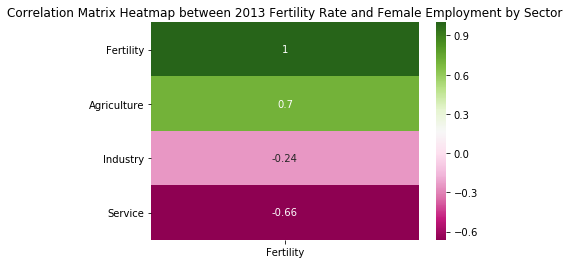

In [209]:
sns.heatmap(df_2013[["Fertility", "Agriculture", "Industry", "Service"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Fertility Rate and Female Employment by Sector");

Female employment in the industry sector has the weakest correlation to fertility rate, and it is a positive correlation. Female employment rate in the agriculture and service sectors have an almost equal correlation in magnitude, but for the agriculture sector it is positive, whereas for the service sector is negative.

We look at the line plots for the two groups of countries to compare female employment in different sectors.

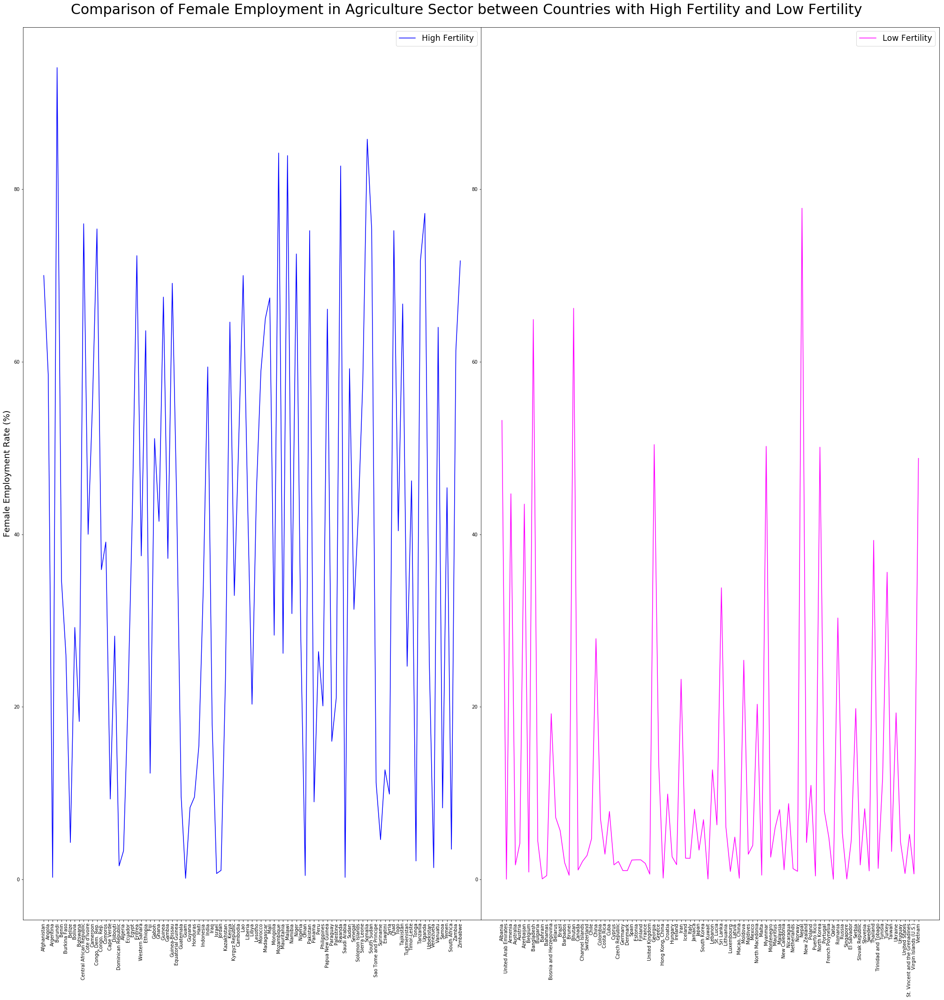

In [210]:
# Using our custom function to create the plots
plot_side_by_side(df_2013_high_fertility["Agriculture"], df_2013_low_fertility["Agriculture"], " in Agriculture Sector")

Looking at the graphs for the agriculture sector, we see that countries with a lower fertility rate tend to have lower female employment in agriculture than countries with a higher fertility rate. We would expect the group with lower fertility to have a lower average employment rate than the other group. We also find that the countries with higher fertility rate seem to have higher variability in the female employment rate across countries, and have a wider range of values.

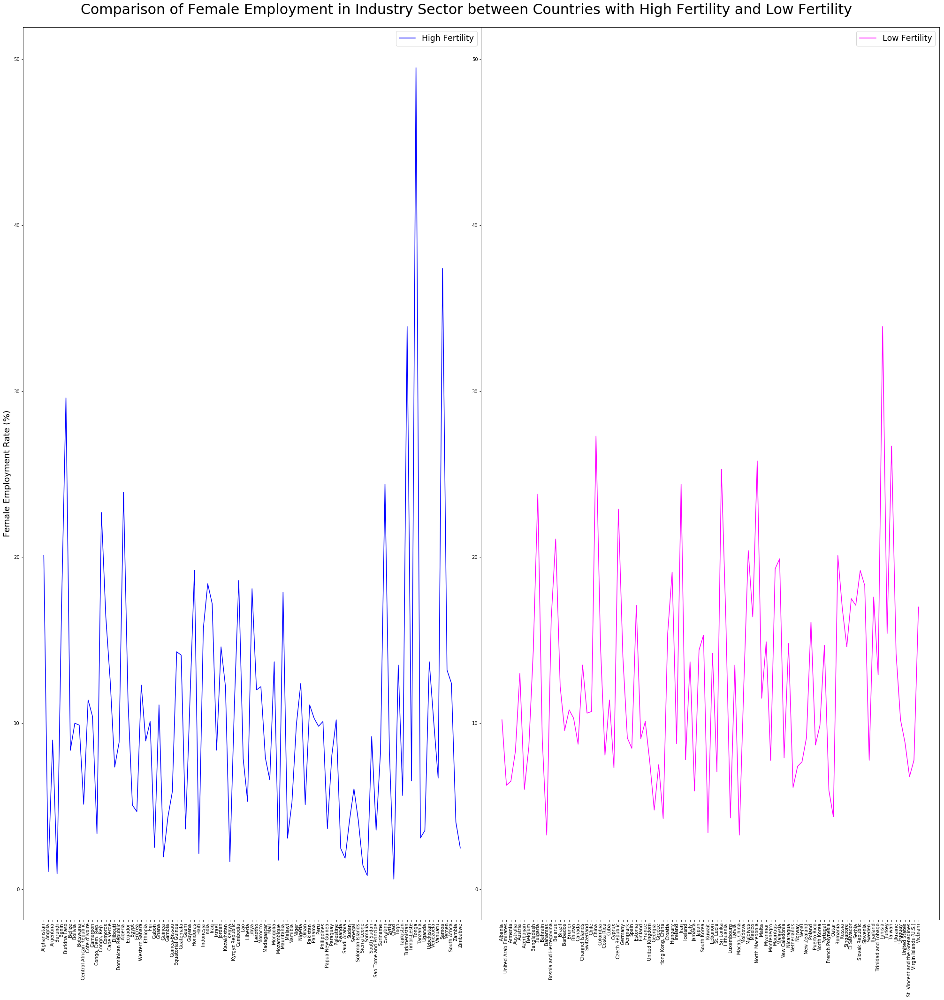

In [211]:
plot_side_by_side(df_2013_high_fertility["Industry"], df_2013_low_fertility["Industry"], " in Industry Sector")

For the industry sector, there is a larger number of visibly high outliers in the female employment rate for countries with a higher fertility rate than the countries with a lower fertility rate. There also seems to be more variability in the higher fertility rate group. However, based on visual inspection, the average employment rate seems to be similar for both groups.

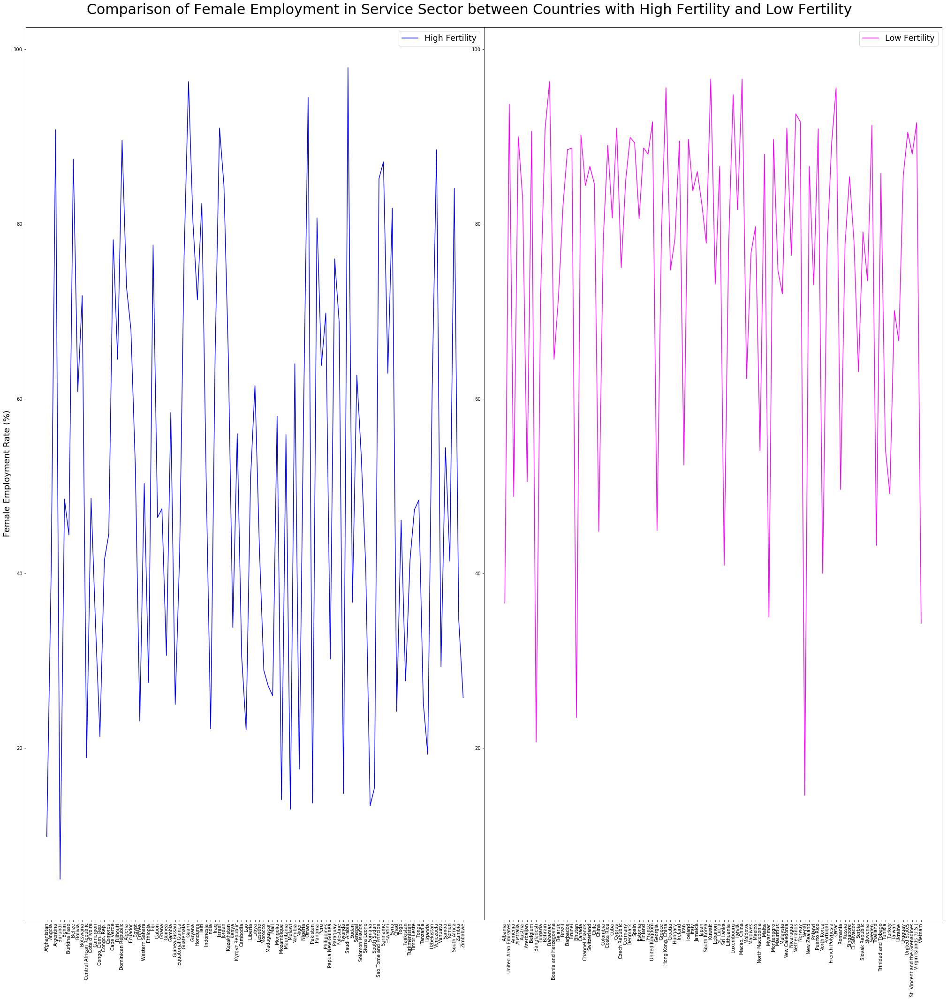

In [212]:
plot_side_by_side(df_2013_high_fertility["Service"], df_2013_low_fertility["Service"], " in Service Sector")

For the service sector, the average female employment rate seems to be higher for the lower fertility rate group than for the higher fertility rate group of countries. The higher fertility rate group, however, has significantly higher variability in the employment rate, and also shows a wider range of values.

We investigate the validity of our observations by looking at descriptive statistics for each group.

In [213]:
# Storing descriptive statistics in a variable, and then displaying them
high_sector_stats = df_2013_high_fertility[["Fertility", "Agriculture", "Industry", "Service"]].describe()
display(high_sector_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
high_sector_CV = high_sector_stats.loc["std"] / high_sector_stats.loc["mean"]
print("Coefficients of Variation:")
display(high_sector_CV)

,Fertility,Agriculture,Industry,Service
count,95.000000,95.000000,95.000000,95.000000
mean,3.943263,38.983895,10.332516,50.692526
std,1.254652,26.685637,8.135468,24.435965
min,2.340000,0.118000,0.593000,4.990000
25%,2.755000,15.750000,4.495000,29.100000
50%,3.810000,37.200000,9.190000,48.600000
75%,4.890000,64.300000,12.850000,69.300000
max,7.380000,94.100000,49.500000,97.900000


Coefficients of Variation:


Fertility      0.318176
Agriculture    0.684530
Industry       0.787366
Service        0.482043
dtype: float64

In [214]:
# Storing descriptive statistics in a variable, and then displaying them
low_sector_stats = df_2013_low_fertility[["Fertility", "Agriculture", "Industry", "Service"]].describe()
display(low_sector_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
low_sector_CV = low_sector_stats.loc["std"] / low_sector_stats.loc["mean"]
print("Coefficients of Variation:")
display(low_sector_CV)

,Fertility,Agriculture,Industry,Service
count,94.000000,94.000000,94.000000,94.000000
mean,1.743085,11.795068,12.686596,75.520213
std,0.311065,17.468110,6.175041,19.172306
min,1.070000,0.009970,3.250000,14.600000
25%,1.500000,1.370000,7.827500,71.700000
50%,1.750000,4.285000,11.450000,81.850000
75%,1.997500,11.575000,16.275000,89.450000
max,2.300000,77.800000,33.900000,96.600000


Coefficients of Variation:


Fertility      0.178456
Agriculture    1.480967
Industry       0.486737
Service        0.253870
dtype: float64

For the agriculture sector, the vast differences in the median and mean values for each group confirm that there is lower female employment in the sector in countries with lower fertility rate. However, contrary to our prior observation, the statistics show that countries with lower fertility rate have a CV value over twice that of the higher fertility rate group of countries.

For the industry sector, the mean and median values for each group are asimilar, with the lower fertility rate group having slightly higher values. There is more variability for countries in the higher fertility rate group than the lower fertility group. The *max* value is much higher for the countries in the higher fertility group, supporting our observation about outliers having higher values in that group.

For female employment rate in the service sector, the higher fertility rate group has lower mean and median employment rates. This group also has higher variability, and a wider range of values.

We will now look at the correlation between female employment in the different sectors and fertility rate, for each group separately.

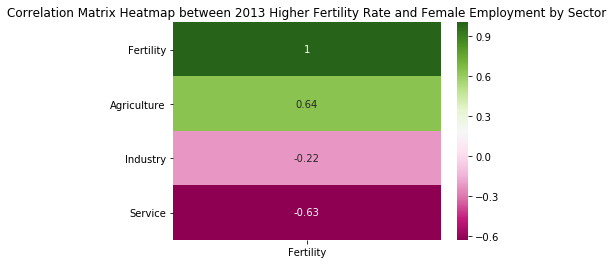

In [215]:
sns.heatmap(df_2013_high_fertility[["Fertility", "Agriculture", "Industry", "Service"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Higher Fertility Rate and Female Employment by Sector");

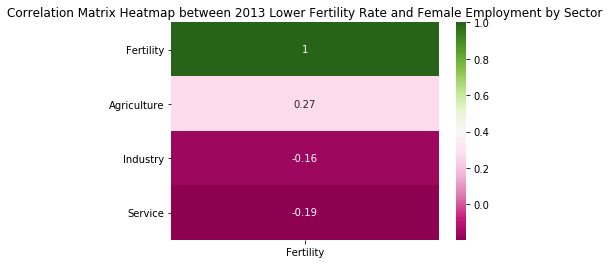

In [216]:
sns.heatmap(df_2013_low_fertility[["Fertility", "Agriculture", "Industry", "Service"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Lower Fertility Rate and Female Employment by Sector");

We find that for countries with higher fertility rate, there is a much stronger correlation for two sectors: a strong positive correlation for the agriculture sector and a strong negative correlation for the service sector. The countries with lower fertility rate have a weaker correlation in both cases. However, there is a weak negative correlation between fertility rate and female employment rate that is almost equal for countries in both groups.

### Research Question 3: Is the fertility rate more closely related to the female employment rate for one particular employment status than the other status?

We now turn to the relationship between fertility rate and the female employment rate for two employment statuses, family workers and self-employed workers. We'll first look at the correlation between fertility rate and each indicator.

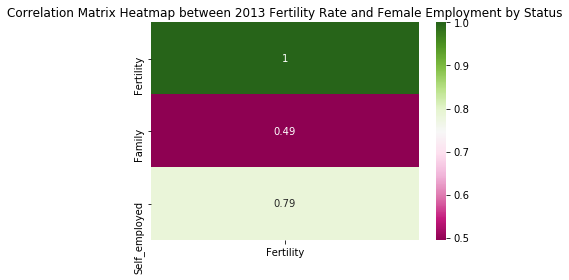

In [217]:
sns.heatmap(df_2013[["Fertility", "Family", "Self_employed"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Fertility Rate and Female Employment by Status");

We see that fertility rate has a positive correlation with female employment rate for both family workers and self-employed workers. For the family workers, the correlation is moderate, while for self-employed workers, the correlation is much stronger. 

We look at the line plots for the two groups of countries, the group with higher fertility and the group with lower fertility rates, to compare female employment rates for different employment statuses.

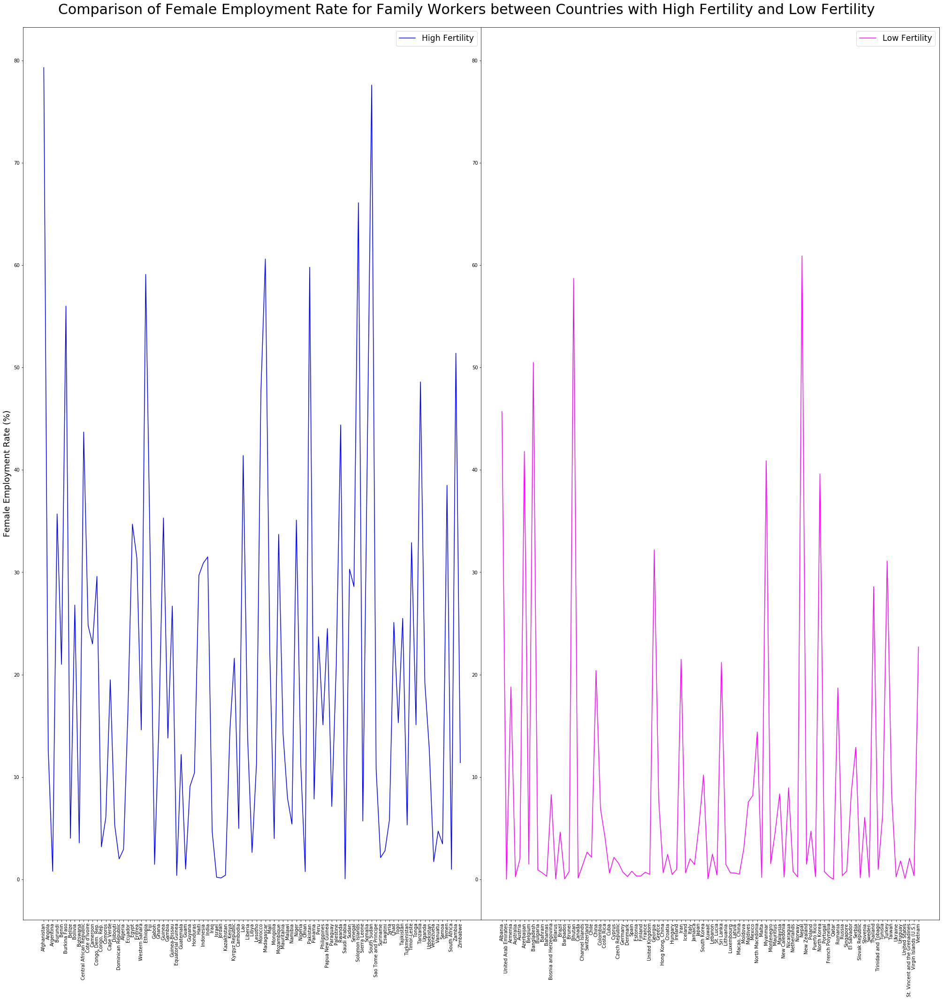

In [218]:
# Using our custom function to create the line plots
plot_side_by_side(df_2013_high_fertility["Family"], df_2013_low_fertility["Family"], " Rate for Family Workers")

For family workers, the graphs show that the average female employment rate for self-employed workers is lower for lower fertility rate countries than for countries with higher fertility rates. There seems to be greater variability in the values for the lower fertility group as well.

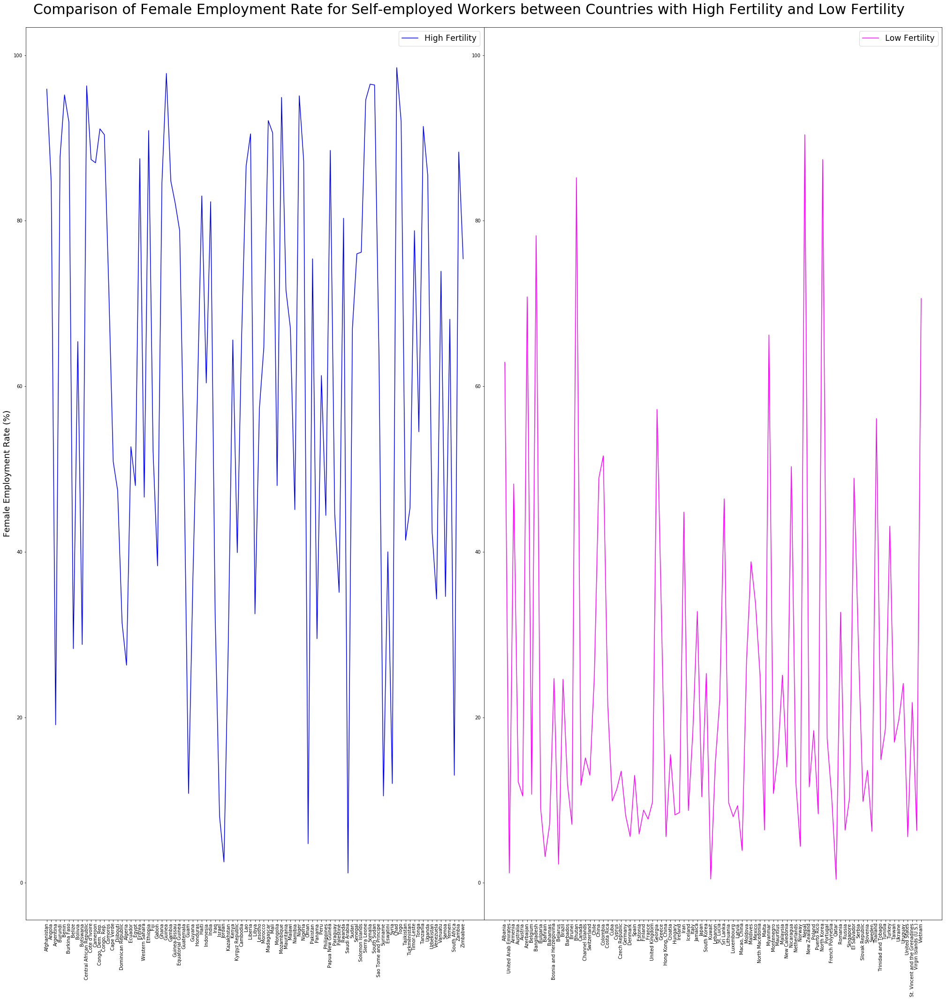

In [219]:
plot_side_by_side(df_2013_high_fertility["Self_employed"], df_2013_low_fertility["Self_employed"], " Rate for Self-employed Workers")

For self-employed workers, there is again a lower average employment rate for countries with lower fertility rates, although varibaility seems to be higher for the higher fertility rate group.

We now look at the descriptive statistics for each group to see whether our observations are valid.

In [220]:
# Storing descriptive statistics in a variable, and then displaying them
high_status_stats = df_2013_high_fertility[["Fertility", "Family", "Self_employed"]].describe()
display(high_status_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
high_status_CV = high_status_stats.loc["std"] / high_status_stats.loc["mean"]
print("Coefficients of Variation:")
display(high_status_CV)

,Fertility,Family,Self_employed
count,95.000000,95.000000,95.000000
mean,3.943263,20.537938,61.960105
std,1.254652,18.648541,27.586462
min,2.340000,0.046100,1.190000
25%,2.755000,5.145000,40.700000
50%,3.810000,15.100000,66.200000
75%,4.890000,31.150000,87.300000
max,7.380000,79.300000,98.500000


Coefficients of Variation:


Fertility        0.318176
Family           0.908005
Self_employed    0.445229
dtype: float64

In [221]:
# Storing descriptive statistics in a variable, and then displaying them
low_status_stats = df_2013_low_fertility[["Fertility", "Family", "Self_employed"]].describe()
display(low_status_stats)
# Computing the CV values using rows from the descriptive statistics table, and printing them
low_status_CV = low_status_stats.loc["std"] / low_status_stats.loc["mean"]
print("Coefficients of Variation:")
display(low_status_CV)

,Fertility,Family,Self_employed
count,94.000000,94.000000,94.000000
mean,1.743085,7.986863,22.976064
std,0.311065,13.713302,21.454024
min,1.070000,0.009520,0.437000
25%,1.500000,0.478750,8.752500
50%,1.750000,1.510000,13.800000
75%,1.997500,8.257500,27.975000
max,2.300000,60.900000,90.400000


Coefficients of Variation:


Fertility        0.178456
Family           1.716982
Self_employed    0.933755
dtype: float64

The median and mean values for female employment rate for family workers are higher for the higher fertility rate group than for countries with lower fertility. And while both groups have high CV values, variability is much higher for the lower fertility rate group than for the higher fertility group.

For self-employed workers, the lower fertility rate group shows lower median and mean values for female employment rate. This group shows a higher value for CV, though, than the higher fertility rate group.

We now look at the correlation between fertility rate and the employment rate for each employment status, for the two groups of countries separately.

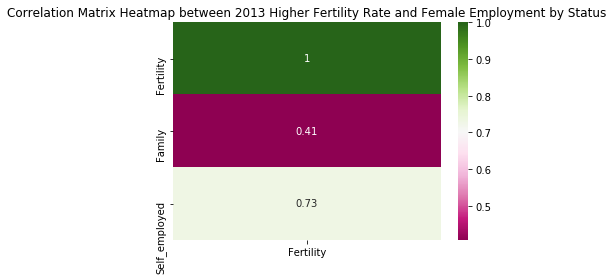

In [222]:
sns.heatmap(df_2013_high_fertility[["Fertility", "Family", "Self_employed"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Higher Fertility Rate and Female Employment by Status");

For the countries with higher fertility rates, there is a strong positive correlation with the employment rate for self-employed workers, and a moderate positive correlation for family workers.

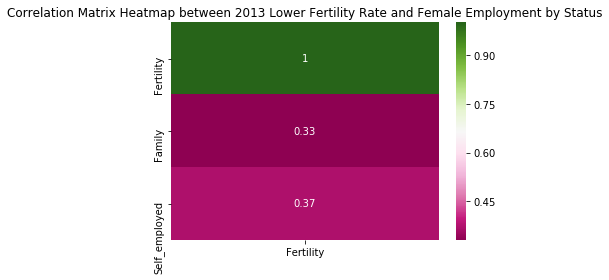

In [223]:
sns.heatmap(df_2013_low_fertility[["Fertility", "Family", "Self_employed"]].corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Lower Fertility Rate and Female Employment by Status");

For countries with lower fertility rates, the correlation between fertility rate and female employment rate for employment statuses is almost equal, and is weak to moderate for each employment status. In both cases, the correlation is positive.

### Research Question 4: Is fertility rate more closely related to female employment rate by sector or female employment rate by employment status?

We will now make comparisons between the relationship that fertility rate has to female employment rate for different employment sectors, versus the relationship it has to female employment rate for different employment statuses. We first look at a correlation heatmap for the fertility rate and our indicators for all countries combined.

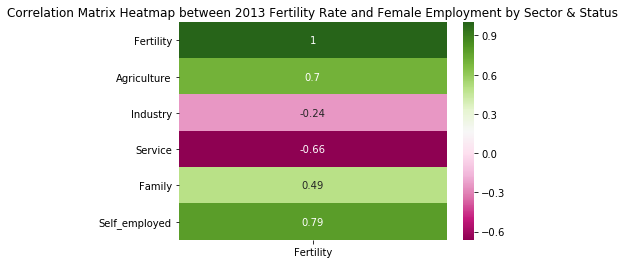

In [224]:
sns.heatmap(df_2013.drop("Employment", axis = 1).corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Fertility Rate and Female Employment by Sector & Status");

We find that the fertility rate has the strongest correlation to the employment rate for self-employed workers, and it is a strong positive correlation. The two next strongest correlations are a positive correlation to the employment rate in the agriculture and a negative correlation to that of the service sector. The absolute value of the lowest correlation to an employment status, family workers, is higher than that of the lowest correlation to an employment sector, the industry sector.

We now look at the same comparisons, but this time for the two groups of countries separately.

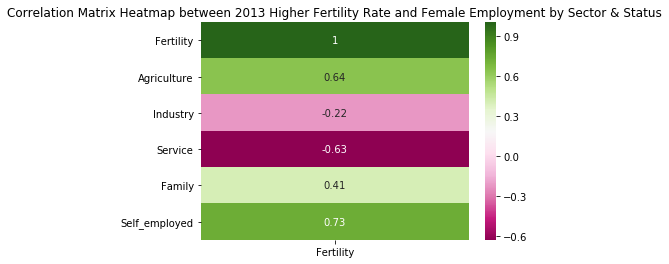

In [225]:
sns.heatmap(df_2013_high_fertility.drop("Employment", axis = 1).corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Higher Fertility Rate and Female Employment by Sector & Status");

The correlation values for the countries with higher fertility rate follow the same pattern as the correlation values for the combined data. The values are also very similar. 

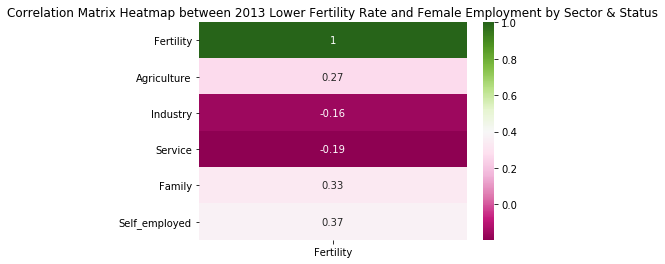

In [226]:
sns.heatmap(df_2013_low_fertility.drop("Employment", axis = 1).corr()[["Fertility"]], annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between 2013 Lower Fertility Rate and Female Employment by Sector & Status");

For the countries with lower fertility rates, the correlations follow the same ranking of employment sectors and statuses from highest to lowest, but the values are significantly lower, and are over a much smaller range. For the countries with lower fertility rates, there is stronger correlation with the employment statuses than with the employment sectors, although none of the values represent particularly strong correlations in either direction.

### Research Question 5: Is female employment rate in any particular sector(s) more closely related to female employment rate for any particular employment status(es)?

We now look at the relationships between the female employment rates for the different sectors and the female employment rates for different employment statuses. We start with a correlation matrix heatmap.

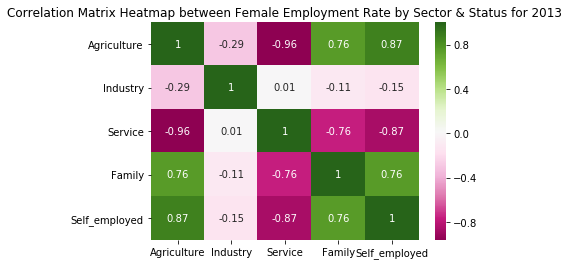

In [227]:
sns.heatmap(df_2013.drop(["Fertility", "Employment"], axis = 1).corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Female Employment Rate by Sector & Status for 2013");

With data for all countries for all levels of fertility rates, we find that the female employment rate in the agriculture sector has high positive correlation to the female employment rate for both family workers and self-employed workers. The correlations of the employment rate in the service sector have the same values as those of the agriculture sector, but for the service sector it is a strong negative correlation with both employment statuses. This makes sense, given that the employment rate in the agriculture sector has a very strong correlation of almost -1 to the employment rate in the service sector. The employment rate in the industry sector has a weak negative correlation to both the employment rate for family workers and for self-employed workers.

We now look at the correlation in female employment rate between employment statuses and employment sectors for the two groups of countries separately.

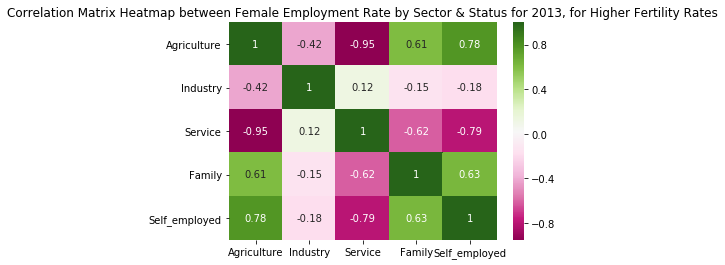

In [228]:
sns.heatmap(df_2013_high_fertility.drop(["Fertility", "Employment"], axis = 1).corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Female Employment Rate by Sector & Status for 2013, for Higher Fertility Rates");

For the countries with higher fertility rate, there is a moderate positive correlation between the employment rate in the agriculture sector and the employment rate for family workers, and there is a high positive correlation with the employment rate for self-employed workers. These values are again mirrored in the correlation of the employment rate in the service industry to the same indicators, but the relationship is a negative correlation instead. For the employment rate in the industry sector, there is a weak negative correlation to the employment rates for both family workers and self-employed workers.

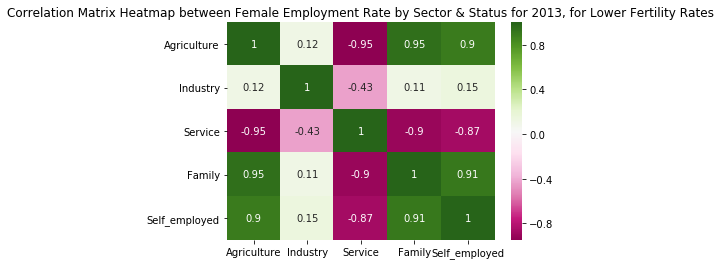

In [229]:
sns.heatmap(df_2013_low_fertility.drop(["Fertility", "Employment"], axis = 1).corr(), annot = True, cmap = "PiYG");
plt.title("Correlation Matrix Heatmap between Female Employment Rate by Sector & Status for 2013, for Lower Fertility Rates");

For the countries with lower fertility rate, we find that there is a very strong positive correlation of almost 1 between the female employment rate in the agriculture sector and the female employment rate for each of the employment statuses. There is a similarly very strong negative correlation between the employment rate in the service sector and the employment rates for both employment statuses. The employment rate in the industry sector has a weak positive correlation to the employment rate for each of the employment statuses.

<a id='conclusions'></a>
## Conclusions

### Results
##### Do countries with higher fertility rate have higher or lower total female employment rate than those with lower fertility rate?
For the first question, we found that there is a low positive correlation between the combined fertility rate and the female employment rate. When we categorized our data by fertility rate, we also found that there is a slightly higher positive correlation for the countries with higher fertility rates than for those with lower fertility rates, but both correlations were positive. This would seem to weakly indicate that the higher the fertility rate, the higher the female employment rate, but that the degree to which it is higher would be stronger for countries with higher fertility rates than for those with lower fertility rates. The descriptive statistics showed us that the mean and median values of employment rates were similar between the two groups, being slightly higher for the higher fertility rate group, but there was more variability in the countries with higher fertility. We can therefore conclude that countries with higher fertility rate show a slightly higher total female employment rate. However, we cannot conclude that higher fertility rates lead to higher female employment rates, as many more factors likely contribute, and our correlations are not enough to base that conclusion on.

##### Is the fertility rate more closely related to the female employment rate in any particular employment sector(s) than in any other sector(s)?
For the second question, we found that the correlation between the combined fertility rate was strongest with the employment rate, positively, in the agriculture sector, and negatively, in the service sector. The correlation was weak with the industry sector. Countries in the category with lower fertility rate had weak correlations to all sectors, while for the other group the correlations were again stronger to equal degrees with the agriculture and service sectors, also in opposite directions. This indicates that countries with higher fertility rates have higher female employment rates in agriculture and lower female employment rates in service. It is possible that patterns in fertility rates lead to this, if the conditions or circumstances of employment in the service sector are not amenable to parenting for example, but this is not a conclusion we can base on this study alone and would require fruther investigation with more data on other factors. Given the start difference in correlations for the two groups, there could also be other differences between the countries i our two categories, that we are only seeing reflected in the fertility and employment rate data, but are not necessarily because of either.

##### Is the fertility rate more closely related to the female employment rate for one particular employment status than the other status?
For the third question, we found that there is a high positive correlation between fertility rate and the employment rate as self-employed workers, and a moderate correlation for family workers. This was for the combined fertility rate data. For the lower fertility rate group, the correlations were also positive, but were almost equal for both employment statuses. For the higher fertility rate group, the correlations mirrored those of the combined data. This could indicate that, for countries with higher fertility rates, it is more likely for female workers to be in self-employment. We were not able to obtain dat for female employment rate as salaried workers, and it would have been helpful to also have this additional comparison to fertility rates. However, for the data we have, there is a higher correlation with self-employed workers. We cannot decisively state that this is because of direct impact of fertility rate, as we only used descriptive statistics and correlations, but it is a distinnct possibility. More data and additional techniques, such as statistical modelling and inferential statistics, would be required for more definitive conclusions.

##### Is fertility rate more closely related to female employment rate by sector or female employment rate by employment status?
For the fourth question, we found that the three strongest correlations between employment rate and the combined fertility rate were with the self-employed worker status, the agriculture sector, and the service sector. The first two were positive correlations and the third was a negative correlation. For both groups of countries with higher and lower fertility rates, we found that the same pattern held, but overall the lower fertility rate group had much weaker correlations than the other group. Thus, we found that there were more strong correlations with the employment sectors than with the employment statuses.

This might mean that the fertility rate of a country affects the sector in which female workers get employed more than it affects their employment status. Or, in combination of the observations, it might also possibly mean that fertility rate impacts self-employment work, but impacts it strongly for the agriculture and service sectors more than it does the industry sector. However, there are likely many other factors that are beyond the scope of those studied in this project that have a causal relationship with this observation, beyond the correlations we have here. This can also be noted in the difference in magnitude of correlation between countries with higher fertility rates and lower fertillity rates. It is possible that external factors that affect the fertility rate for these two groups also affect opportunities and/or perceptions regarding female employment in general, female employment in different sectors, and female employment statuses. These could include social, political, cultural or economic factors that lead to the differences in the fertility rates, and our categorization here may be representative of that, rather than of the fertility rate itself having this impact. It would be valuable to conduct a similar investigation as the one in this project, using data where countries are categorized by similarity in these factors.

We also do not have enough information to mae concrete conclusions about whether these trends are based on patterns in preferences of the workers, or on patterns in the availability of employment options to the workers. This could provide another avenue to explore in a future investigation. It is also prudent to note that, there can be a more complete investigation of this question with the availability of employment rate data for salaried workers, which would lead to additional insights, and possibly amendments to the insights we have gained in this version of the investigation.

##### Is female employment rate in any particular sector(s) more closely related to female employment rate for any particular employment status(es)?
For the final question, we find that for both the combined and categorized data, employment rates in the agriculture and service sectors have a strong correlation with the employment rates for both self-employed and family workers. The correlations with the agriculture sector are positive, and they are negative with the service sector. There is also a very strong negative correlation between the agriculture sector and the service sector. This information in total indicates that countries with higher employment rates in agriculture have higher employment rates of family workers and self-employed workers and lower employment rates in service sector. This shows that much of the work in agriculture involves self-employment or family work, while much of the service work does not, and this intuitively makes sense.

Additionally, given the finding in the second question above that there is a positive and negative correlation between fertility rate and employment rate in agriculture and service sectors respectively, it also follows that countries with higher fertility rates see more female employment as self-employed or family workers in the agriculture sector, as it is intuitively more likely that those with and/or from larger families are involved in family work especially, as well as self-employed work. It is, again, not evident from our study alone whether this is due to preferences, or based on availability of opportunity, or some combination of both in the form of convenience for the female workers, as there are likely many factors that could contribute. This also fits the definitions given by the ILO and the OECD, regarding the scope and characteristics that classify one as a [service worker](https://www.ilo.org/public/english/bureau/stat/isco/isco88/5.htm), or as a family worker, [contributing](https://stats.oecd.org/glossary/detail.asp?ID=443) or [unpaid](https://stats.oecd.org/glossary/detail.asp?ID=2813). Based on these definitons, it would be very unlikely for a worker in the service sector to be self-employed, and a family worker is almost inherently self-employed.

There is a very weak correlation with the industry sector for both employment status for both combined and categorized fertility rate data. It would again have been very helpful here to investigate this sector alongside data for the employment rate for salaried workers, to see how the relationship varies there.

### Limitations
A prominent limitation in this project was the unavailability of data for the female employment rate for salaried workers. Including this employment status in our investigation would have proven especially useful in addressing our last two research questions. For question 4, we would have been able to have a more balanced comparison between the employment rates for the employment sectors and the employment rates for employment statuses. For question 5, we could have gained much more insight into additional relationships. For example, for the correlation between the employment rate in the industry sector and the employment rates in the different sectors, it would have been helpful to look at correlation to the employment rate for salaried workers and how it differed from the other values. Right now, in the absence of this data, we can only surmise that there could have been a stronger correlation between the industry sector and that employment status since, intuitively, workers in the industry sector are probably more likely to be salaried workers than in the agricultural and service sectors. But this is a mere supposition at best, and no conclusive positions can be reached without the data for female employment rates for salaried workers.

Another limitation is that, the employment rate data for the countries does not account for differences in the size of each employment sector across countries. It would be valuable to categorize the countries by the sector in which the country has its highest economic activity, and make comparisons within and across groups. For example, countries for which agriculture does not contribute to the major economic activity would likely have much lower employment rates in that sector than for countries which do, which could potentially distort the data and affect the conclusions we can make from that data. But if grouped with countries with similar patterns of economic activity, for instance countries that have industry as a major economic driver, it would produce much more meaningful results to make comparisons with this context, and would lead to better quality analysis for both the agriculture and the industry sectors.

<a id='resources'></a>
## Resources & References
* I learned about how to iteratively show the heads of multiple dataframes returned in a for loop from [this Stack Overflow answer](https://stackoverflow.com/a/58061987).    
* I learned about the existence of the *suptitle* function from [this Stack Overflow answer](https://stackoverflow.com/a/19625612).  I then learned about how to use the function from the [matplotlib.pyplot.suptitle official documentation](https://matplotlib.org/3.5.3/api/_as_gen/matplotlib.pyplot.suptitle.html).  
* I learned about additional text formatting options for the *suptitle* function from [matplotlib.text official documentation](https://matplotlib.org/3.5.3/api/text_api.html).  
* I learned about how to copy values from dataframe columns to a new dataframe from [this Stack Overflow answer](https://stackoverflow.com/a/45747686).  
* I learned about colour palettes for Seaborn heatmaps from examples shown in [this article](https://www.python-graph-gallery.com/92-control-color-in-seaborn-heatmaps).